# Model used Yolo8
It has 2 parts: Data Handling and Model training and prediction

The files to be used further:
1. Folder with all images named: probe_images
2. Folder with all test images named: probe_test_images (I manually created this folder)
3. annotations.csv (created in rawdata.ipy)

In [ ]:
import os, shutil
import sys
import pandas as pd
import numpy as np
!pip install ultralytics
!pip install cvzone


## Data Handling

In [ ]:
os.getcwd()
IMAGES_PATH ="/content/probe_images"
TEST_IMAGES_PATH = "/content/probe_test_images"
print(os.listdir(TEST_IMAGES_PATH))
print(len(os.listdir(TEST_IMAGES_PATH)))

['E300SA22440035_01533_862_1flight_6300_0.jpg', 'E300PREMP00002_00725_216_1flight_8700_2.jpg', 'EL300858804493_00188_043_1flight_3000_0.jpg', 'EL300858804493_00330_112_1flight_9600_2.jpg', 'E300SA23130257_00057_043_1flight_8100_0.jpg', 'EL300858804493_00184_039_1flight_9300_2.jpg', 'E300SA22440034_00452_136_1flight_2100_2.jpg', 'E300PREMP00002_00725_216_1flight_900_2.jpg', 'E300SA23130257_00295_209_1flight_0_2.jpg', 'EL300858804493_00193_048_1flight_1500_0.jpg', 'E300SA23130257_00301_214_1flight_900_0.jpg', 'EL300858804493_00330_112_1flight_2400_2.jpg', 'E300SA23130257_00054_035_1flight_1200_0.jpg', 'EL300858804493_00184_039_1flight_3300_2.jpg', 'E300SA22440034_00451_135_1flight_3000_2.jpg', 'E300PREMP00002_00725_216_1flight_3900_2.jpg', 'E300SA22440034_00465_143_1flight_1800_2.jpg', 'E300SA22440034_00447_133_1flight_8400_2.jpg', 'E300SA23130257_00057_043_1flight_11700_0.jpg', 'E300SA22440034_00447_133_1flight_9000_2.jpg', 'E300SA23130257_00060_045_1flight_900_0.jpg', 'E300PREMP00002_0

### Make TRAIN, VAL, TEST sets as per YOLO input data structure

In [ ]:
print(os.getcwd())
if not os.path.exists("/content/data"):
    os.mkdir("data")
    os.chdir("/content/data")
    print(os.getcwd())

    if not os.path.exists("train"):
      os.mkdir("train")
      if not os.path.exists("train/images"):
        os.mkdir("train/images")
        os.mkdir("train/labels")
        print(os.getcwd())

    if not os.path.exists("val"):
      os.mkdir("val")
      if not os.path.exists("val/images"):
        os.mkdir("val/images")
        os.mkdir("val/labels")
        print(os.getcwd())

    if not os.path.exists("test"):
      os.mkdir("test")
      if not os.path.exists("test/images"):
        os.mkdir("test/images")
        os.mkdir("test/labels")
        print(os.getcwd())

/content
/content/data
/content/data
/content/data
/content/data


In [ ]:
files = [f for f in os.listdir(IMAGES_PATH) if f not in (os.listdir(TEST_IMAGES_PATH))]
# print(len(files))
docs = np.array(files)

#split the train set to train and val with ratio 9:1
ratio = 0.9
doc_split = np.split(docs, [round(len(docs) * ratio)])
print(len(doc_split[0]), len(doc_split[1])) # split into 249 and 28

idx = np.hstack((np.ones(len(doc_split[0])), np.zeros(len(doc_split[1])))) # generate indices
np.random.shuffle(idx) # shuffle to make training data and val data random

train = docs[idx == 1]
val = docs[idx == 0]

print(os.getcwd())
for f in os.listdir(IMAGES_PATH):
    if f in train:
        shutil.copy(os.path.join(IMAGES_PATH, f), "train/images")
    if f in val:
        shutil.copy(os.path.join(IMAGES_PATH, f), "val/images")

for f in os.listdir(TEST_IMAGES_PATH):
    shutil.copy(os.path.join(TEST_IMAGES_PATH, f), "test/images")

249 28
/content/data


In [ ]:
train_path ="/content/data/train/images"
test_path = "/content/data/test/images"
val_path = "/content/data/val/images"

print("TRAIN Images: " + str(len(os.listdir(train_path))))
print("TEST Images: " + str(len(os.listdir(test_path))))
print("VAL Images: " + str(len(os.listdir(val_path))))

TRAIN Images: 249
TEST Images: 31
VAL Images: 28


In [ ]:
os.chdir("/content")
df = pd.read_csv('annotations.csv')
df.head()
# df["x_min"]
# df['new'] = 'y'
# Same as,
df.loc[:, 'label'] = '0'
df.tail()

,file_name,start_x,start_y,end_x,end_y,label
303,EL300858804493_00330_112_1flight_9000_2.jpg,329.0,0.0,148.0,141.0,0
304,EL300858804493_00330_112_1flight_9600_2.jpg,329.0,0.0,145.0,142.0,0
305,EL300858804493_00330_112_1flight_10200_2.jpg,329.0,0.0,135.0,144.0,0
306,EL300858804493_00330_112_1flight_10800_2.jpg,329.0,0.0,135.0,144.0,0
307,EL300858804493_00330_112_1flight_11400_2.jpg,329.0,0.0,135.0,144.0,0


### Data Pre-Processing

In [ ]:
def SaveBoundingBoxToFile(row):
   w_img = 640
   h_img = 400
   row['x'] = round(((row["end_x"]+row["start_x"])/2)/w_img,6)
   row['y'] = round(((row["end_y"]+row["start_y"])/2)/h_img,6)
   row['width'] = abs(round((row["end_x"]-row["start_x"])/w_img,6))
   row['height'] = abs(round((row["end_y"]-row["start_y"])/h_img,6))
   return row

df = df.apply(lambda x: SaveBoundingBoxToFile(x), axis=1)
df.tail()

,file_name,start_x,start_y,end_x,end_y,label,x,y,width,height
303,EL300858804493_00330_112_1flight_9000_2.jpg,329.0,0.0,148.0,141.0,0,0.372656,0.17625,0.282813,0.3525
304,EL300858804493_00330_112_1flight_9600_2.jpg,329.0,0.0,145.0,142.0,0,0.370312,0.17750,0.287500,0.3550
305,EL300858804493_00330_112_1flight_10200_2.jpg,329.0,0.0,135.0,144.0,0,0.362500,0.18000,0.303125,0.3600
306,EL300858804493_00330_112_1flight_10800_2.jpg,329.0,0.0,135.0,144.0,0,0.362500,0.18000,0.303125,0.3600
307,EL300858804493_00330_112_1flight_11400_2.jpg,329.0,0.0,135.0,144.0,0,0.362500,0.18000,0.303125,0.3600


### Make TRAIN, VAL, TEST sets as per YOLO input data structure
data/  <br>
|-- train/ <br>
|-- |-- images/ <br>
|-- |-- labels/ <br>
|-- val/ <br>
|-- |-- images/ <br>
|-- |-- labels/ <br>
|-- test/ <br>
|-- |-- images/ <br>
|-- |-- labels/ <br>
|-- data.yaml <br>

In [ ]:
columns = ['label', 'x', 'y', 'width', 'height']
global df_train, df_test, df_val
df_train, df_test, df_val = pd.DataFrame(columns=df.columns),pd.DataFrame(columns=df.columns),pd.DataFrame(columns=df.columns)

df_test

,file_name,start_x,start_y,end_x,end_y,label,x,y,width,height


In [ ]:
# dummy_df = pd.DataFrame(columns=df.columns)
# path = "/content/data/test/labels"
# columns = ['label', 'x', 'y', 'width', 'height']
# for i,row in df.iterrows():
#   if row["file_name"] in os.listdir(TEST_IMAGES_PATH):
#     dummy_df = pd.concat([dummy_df, df.iloc[[i]]], axis=0, ignore_index=True)
#     df.iloc[[i]].to_csv(os.path.join(path, str(row["file_name"].rsplit('.', 1)[0])+".txt"), sep=' ', header = False, index=False, columns = columns)
#     break
#   # dummy_df.append(row,ignore_index=True)

# print(dummy_df)
#   # break

In [ ]:
train_label_path ="/content/data/train/labels"
test_label_path = "/content/data/test/labels"
val_label_path = "/content/data/val/labels"
def SegregateAnnotationFile(df, df_test, df_train, df_val):
    for i,row in df.iterrows():
      if row["file_name"] in os.listdir(TEST_IMAGES_PATH):
        df_test = pd.concat([df_test, df.iloc[[i]]], axis=0, ignore_index=True)
        df.iloc[[i]].to_csv(os.path.join(test_label_path, str(row["file_name"].rsplit('.', 1)[0])+".txt"), sep=' ', header = False, index=False, columns = columns)

      elif row["file_name"] in val:
        df_val = pd.concat([df_val, df.iloc[[i]]], axis=0, ignore_index=True)
        df.iloc[[i]].to_csv(os.path.join(val_label_path, str(row["file_name"].rsplit('.', 1)[0])+".txt"), sep=' ', header = False, index=False, columns = columns)

      else:
        df_train = pd.concat([df_train, df.iloc[[i]]], axis=0, ignore_index=True)
        df.iloc[[i]].to_csv(os.path.join(train_label_path, str(row["file_name"].rsplit('.', 1)[0])+".txt"), sep=' ', header = False, index=False, columns = columns)

    return df_test, df_train, df_val

df_test, df_train, df_val = SegregateAnnotationFile(df, df_test, df_train, df_val)

<ipython-input-12-9b724ff69c92>:7: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_test = pd.concat([df_test, df.iloc[[i]]], axis=0, ignore_index=True)
<ipython-input-12-9b724ff69c92>:11: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_val = pd.concat([df_val, df.iloc[[i]]], axis=0, ignore_index=True)
<ipython-input-12-9b724ff69c92>:15: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or al

In [ ]:
df_test
df_train
df_val

,file_name,start_x,start_y,end_x,end_y,label,x,y,width,height
0,E300PREMP00002_00725_216_1flight_1500_2.jpg,90.0,0.0,133.0,208.0,0,0.174219,0.26000,0.067187,0.5200
1,E300PREMP00002_00725_216_1flight_4500_2.jpg,90.0,0.0,133.0,208.0,0,0.174219,0.26000,0.067187,0.5200
2,E300PREMP00002_00725_216_1flight_8100_2.jpg,90.0,0.0,133.0,208.0,0,0.174219,0.26000,0.067187,0.5200
3,E300PREMP00002_00726_217_1flight_12600_2.jpg,90.0,0.0,133.0,208.0,0,0.174219,0.26000,0.067187,0.5200
4,E300PREMP00002_00727_218_1flight_7200_2.jpg,90.0,0.0,133.0,208.0,0,0.174219,0.26000,0.067187,0.5200
5,E300SA22440034_00447_133_1flight_0_2.jpg,90.0,0.0,133.0,208.0,0,0.174219,0.26000,0.067187,0.5200
6,E300SA22440034_00447_133_1flight_2400_2.jpg,83.0,0.0,123.0,210.0,0,0.160938,0.26250,0.062500,0.5250
7,E300SA22440034_00447_133_1flight_4200_2.jpg,83.0,0.0,123.0,210.0,0,0.160938,0.26250,0.062500,0.5250
8,E300SA22440034_00447_133_1flight_6300_2.jpg,83.0,0.0,123.0,210.0,0,0.160938,0.26250,0.062500,0.5250
9,E300SA22440034_00447_133_1flight_7500_2.jpg,83.0,0.0,123.0,210.0,0,0.160938,0.26250,0.062500,0.5250


### Create Yaml file
Manually update the data.yaml to :

train: ../train/images <br>
val: ../val/images <br>
test: ../test/images <br>

nc: 1 <br>
names: ['probe']


In [ ]:
import yaml

# S = ruamel.yaml.scalarstring.SingleQuotedScalarString

l = [{'train':'../train/images', 'val':'../val/images', 'nc': 1,'names': ['probe']}]
print(yaml.dump(l))
os.chdir("/content/data")
with open('data.yaml', 'w') as yaml_file:
    yaml.dump(l, yaml_file, default_flow_style=False)

- names:
  - probe
  nc: 1
  train: ../train/images
  val: ../val/images



In [ ]:
os.chdir("/content")

## Model Training and Prediction

### Model train using Yolo 8 nano

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolov8n.yaml")  # build a new model from YAML
model = YOLO("yolov8n.pt")  # load a pretrained model (recommended for training)
model = YOLO("yolov8n.yaml").load("yolov8n.pt")  # build from YAML and transfer weights

# Train the model
results = model.train(data="/content/data/data.yaml", epochs=25)

100%|██████████| 6.25M/6.25M [00:00<00:00, 152MB/s]


Transferred 355/355 items from pretrained weights
Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/content/data/data.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=yolov8n.pt, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop

100%|██████████| 755k/755k [00:00<00:00, 44.7MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/data/train/labels... 249 images, 0 backgrounds, 0 corrupt: 100%|██████████| 249/249 [00:00<00:00, 1176.55it/s]

train: New cache created: /content/data/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.0 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/data/val/labels... 28 images, 0 backgrounds, 0 corrupt: 100%|██████████| 28/28 [00:00<00:00, 1988.60it/s]

val: New cache created: /content/data/val/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/25         0G      2.481       4.11      2.192         21        640: 100%|██████████| 16/16 [03:52<00:00, 14.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.35s/it]

                   all         28         28    0.00155      0.464      0.056     0.0183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/25         0G      2.083      3.431       1.81         17        640: 100%|██████████| 16/16 [03:40<00:00, 13.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:06<00:00,  6.07s/it]

                   all         28         28    0.00202      0.607     0.0437     0.0156



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/25         0G      2.011      3.308      1.739         16        640: 100%|██████████| 16/16 [03:39<00:00, 13.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.68s/it]

                   all         28         28      0.422     0.0357     0.0667     0.0458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/25         0G      2.029      3.186      1.787         19        640: 100%|██████████| 16/16 [03:39<00:00, 13.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.08s/it]

                   all         28         28     0.0604      0.214     0.0281      0.012



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/25         0G      2.028      3.048      1.746         10        640: 100%|██████████| 16/16 [03:37<00:00, 13.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.68s/it]

                   all         28         28       0.57      0.179      0.172     0.0695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/25         0G          2      2.987      1.755         17        640: 100%|██████████| 16/16 [03:40<00:00, 13.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.77s/it]

                   all         28         28      0.115      0.214     0.0579     0.0235



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/25         0G      1.895      2.783      1.663         11        640: 100%|██████████| 16/16 [03:34<00:00, 13.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.81s/it]

                   all         28         28      0.452      0.286      0.239      0.144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/25         0G      1.913      2.701      1.721         16        640: 100%|██████████| 16/16 [03:40<00:00, 13.78s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:06<00:00,  6.03s/it]

                   all         28         28      0.431       0.25      0.229      0.156



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/25         0G      1.828      2.485       1.66         14        640: 100%|██████████| 16/16 [03:29<00:00, 13.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.63s/it]

                   all         28         28      0.401      0.321      0.264      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/25         0G      1.827      2.479      1.627         16        640: 100%|██████████| 16/16 [03:35<00:00, 13.49s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.81s/it]

                   all         28         28      0.483       0.25      0.191      0.123



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/25         0G      1.781      2.296      1.595         22        640: 100%|██████████| 16/16 [03:34<00:00, 13.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:06<00:00,  6.07s/it]

                   all         28         28      0.409      0.179      0.161      0.122



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/25         0G      1.731      2.284      1.602         19        640: 100%|██████████| 16/16 [03:30<00:00, 13.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.63s/it]

                   all         28         28      0.799       0.25      0.279      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/25         0G       1.59      2.093      1.479         15        640: 100%|██████████| 16/16 [03:37<00:00, 13.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.95s/it]

                   all         28         28       0.59      0.321      0.335      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/25         0G      1.625      2.097      1.543         11        640: 100%|██████████| 16/16 [03:30<00:00, 13.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.62s/it]

                   all         28         28      0.786      0.357       0.39      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/25         0G      1.559      1.975      1.488         18        640: 100%|██████████| 16/16 [03:38<00:00, 13.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.57s/it]

                   all         28         28      0.719      0.321      0.335      0.233


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/25         0G      1.541      2.158      1.535          9        640: 100%|██████████| 16/16 [03:35<00:00, 13.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.84s/it]

                   all         28         28       0.69      0.286      0.313      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/25         0G      1.386      1.923      1.427          8        640: 100%|██████████| 16/16 [03:30<00:00, 13.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.68s/it]

                   all         28         28      0.706      0.343      0.417      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/25         0G      1.419      1.804      1.409          9        640: 100%|██████████| 16/16 [03:38<00:00, 13.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.08s/it]

                   all         28         28      0.483      0.357       0.37      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/25         0G      1.355      1.761      1.406          9        640: 100%|██████████| 16/16 [03:30<00:00, 13.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.64s/it]

                   all         28         28      0.968      0.429      0.504      0.285



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/25         0G      1.335      1.675      1.374          9        640: 100%|██████████| 16/16 [03:33<00:00, 13.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.90s/it]

                   all         28         28      0.464      0.403      0.418      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/25         0G      1.378      1.664      1.374          9        640: 100%|██████████| 16/16 [03:29<00:00, 13.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.56s/it]

                   all         28         28      0.732       0.39       0.43      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/25         0G      1.233      1.535       1.34          9        640: 100%|██████████| 16/16 [03:35<00:00, 13.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.22s/it]

                   all         28         28      0.632      0.429      0.467      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/25         0G      1.216       1.42      1.305          9        640: 100%|██████████| 16/16 [03:29<00:00, 13.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.54s/it]

                   all         28         28      0.528      0.464      0.448      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/25         0G      1.164      1.357      1.307          8        640: 100%|██████████| 16/16 [03:32<00:00, 13.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:05<00:00,  5.97s/it]

                   all         28         28      0.792      0.393       0.48      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/25         0G      1.109      1.423      1.258          8        640: 100%|██████████| 16/16 [03:30<00:00, 13.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.79s/it]

                   all         28         28      0.821      0.393      0.483      0.315



25 epochs completed in 1.540 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8n summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.18s/it]


                   all         28         28      0.791      0.393       0.48      0.329
Speed: 1.6ms preprocess, 142.2ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train


In [ ]:
results = model.predict(test_path + "/E300PREMP00002_00725_216_1flight_300_2.jpg")


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_300_2.jpg: 416x640 1 probe, 169.2ms
Speed: 2.8ms preprocess, 169.2ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 640)


In [ ]:
results
result = results[0]
output = []

for box in result.boxes:
  x1, y1, x2, y2 = [
    round(x) for x in box.xyxy[0].tolist()
  ]
  class_id = box.cls[0].item()
  prob = round(box.conf[0].item(), 2)
  output.append([
    x1, y1, x2, y2, result.names[class_id], prob
  ])

output

[[85, 0, 131, 200, 'probe', 0.46]]

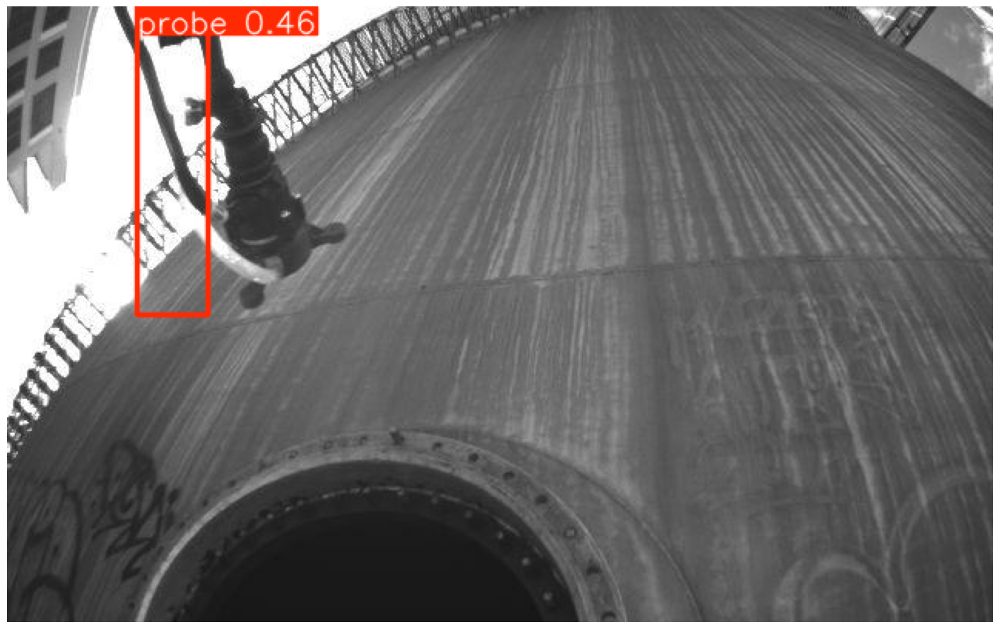

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(5,5))
imag = results[0].plot()
plt.imshow(imag)
plt.axis('off')
plt.show()


image 1/1 /content/data/test/images/E300SA22440034_00465_143_1flight_1800_2.jpg: 416x640 1 probe, 164.5ms
Speed: 5.9ms preprocess, 164.5ms inference, 2.2ms postprocess per image at shape (1, 3, 416, 640)


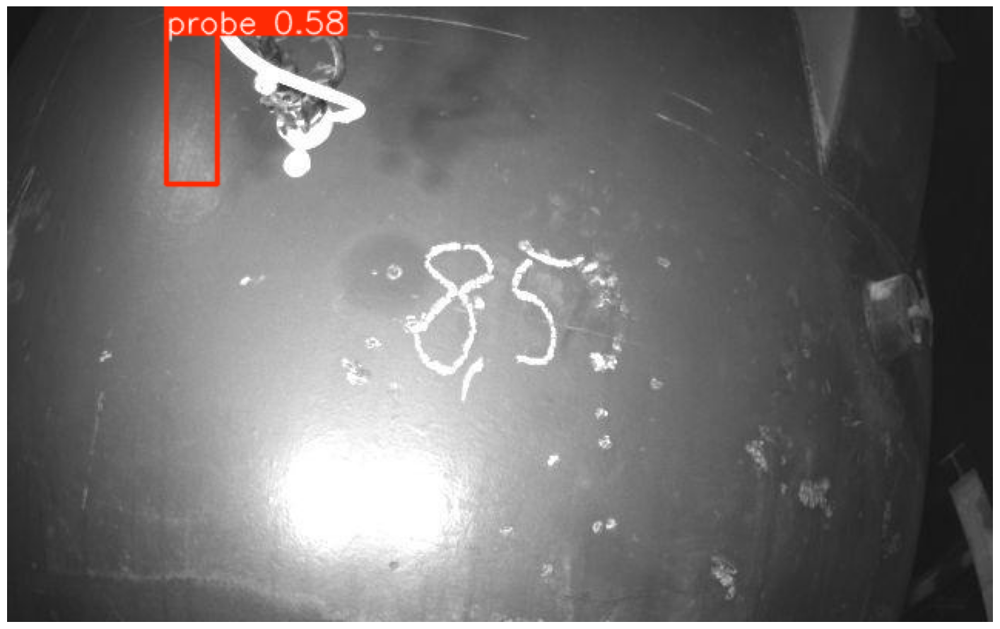


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_9300_2.jpg: 416x640 1 probe, 217.1ms
Speed: 2.5ms preprocess, 217.1ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)


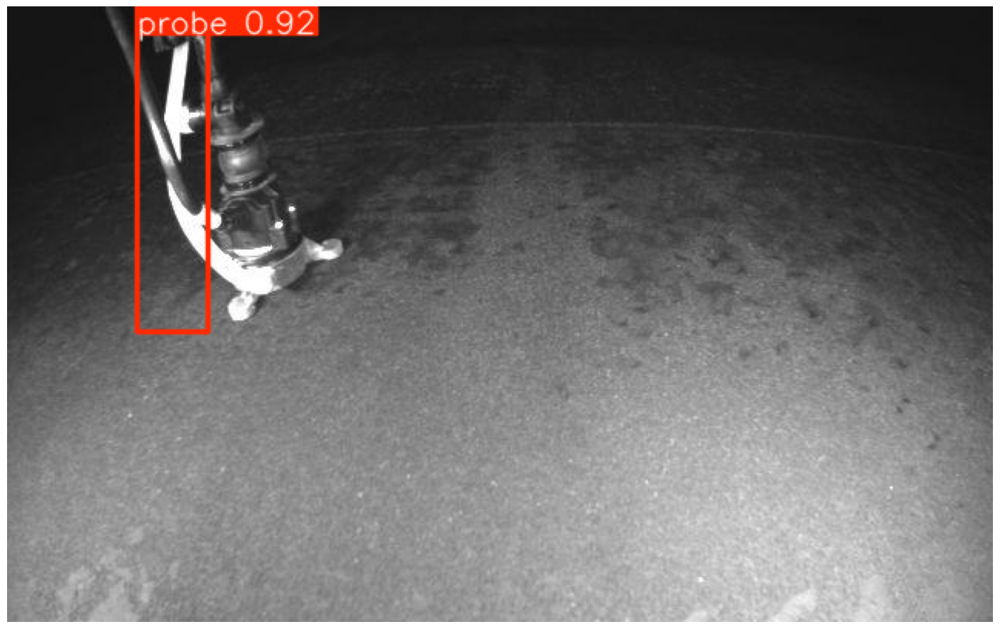


image 1/1 /content/data/test/images/E300SA22440035_01533_862_1flight_1500_0.jpg: 416x640 (no detections), 239.4ms
Speed: 2.4ms preprocess, 239.4ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)


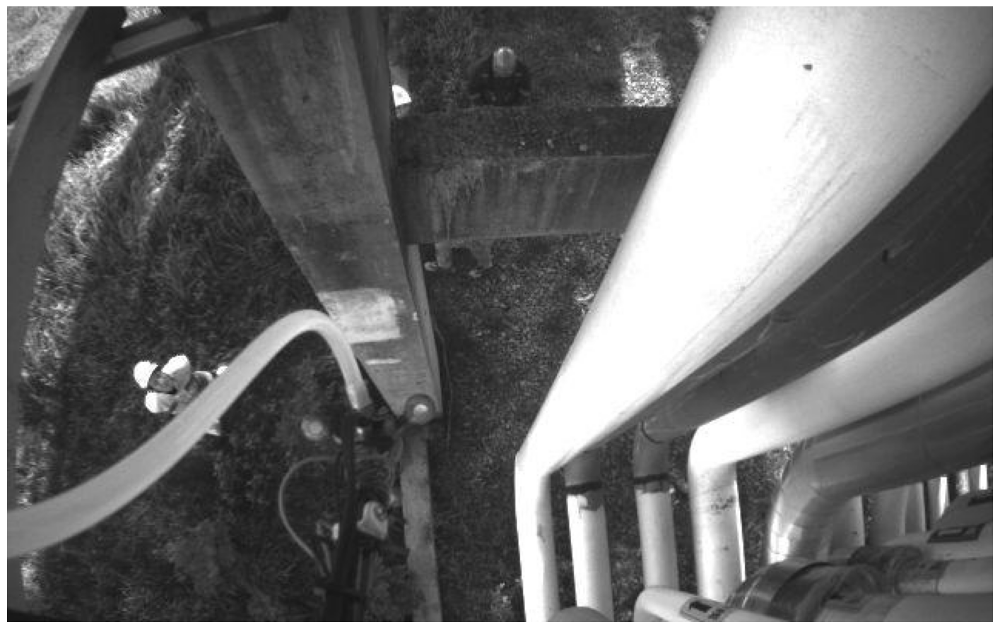


image 1/1 /content/data/test/images/E300SA22440034_00447_133_1flight_8400_2.jpg: 416x640 1 probe, 244.8ms
Speed: 2.6ms preprocess, 244.8ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 640)


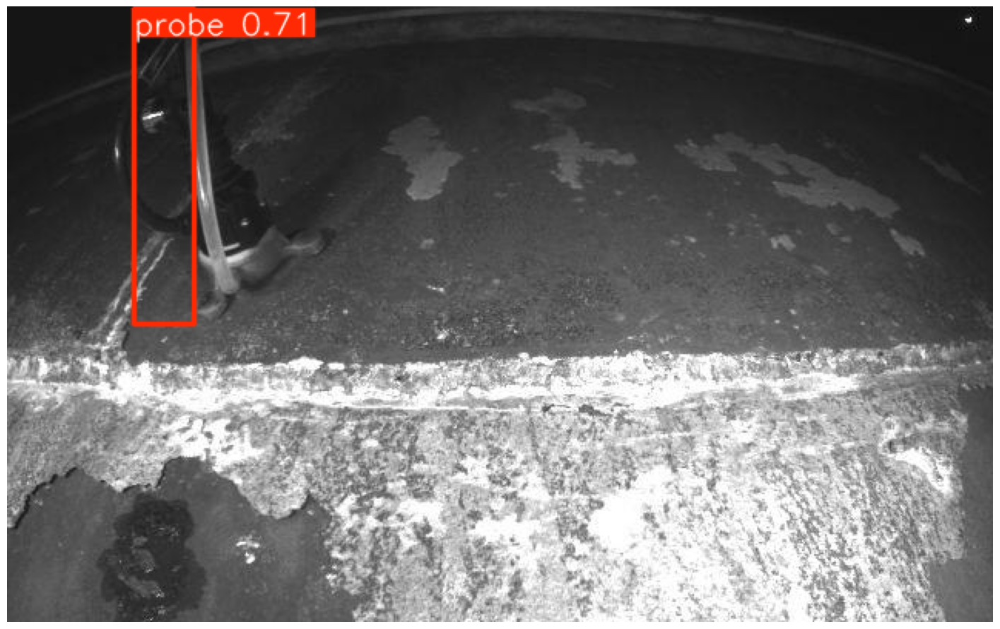


image 1/1 /content/data/test/images/E300SA23130257_00267_199_1flight_6000_2.jpg: 416x640 1 probe, 234.0ms
Speed: 2.4ms preprocess, 234.0ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)


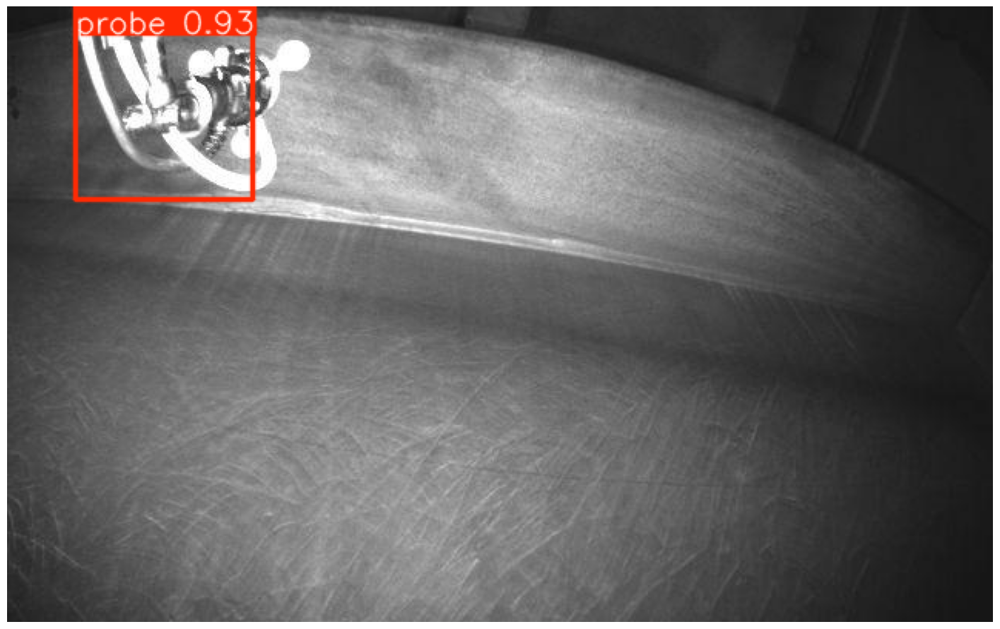


image 1/1 /content/data/test/images/E300SA23130257_00060_045_1flight_900_0.jpg: 416x640 (no detections), 300.0ms
Speed: 2.8ms preprocess, 300.0ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


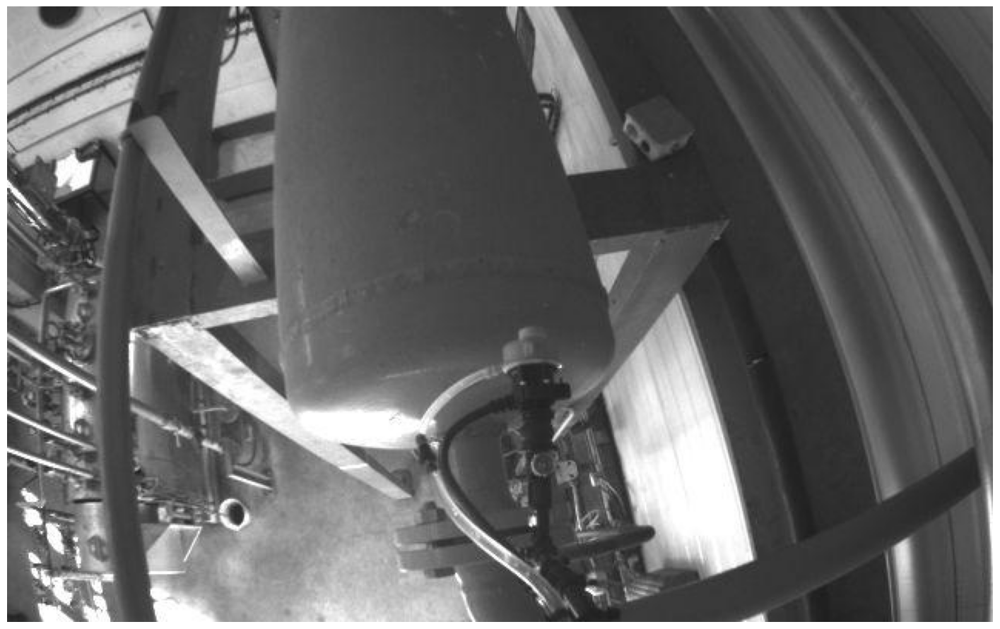


image 1/1 /content/data/test/images/E300SA23130257_00054_035_1flight_1200_0.jpg: 416x640 (no detections), 236.7ms
Speed: 2.7ms preprocess, 236.7ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 640)


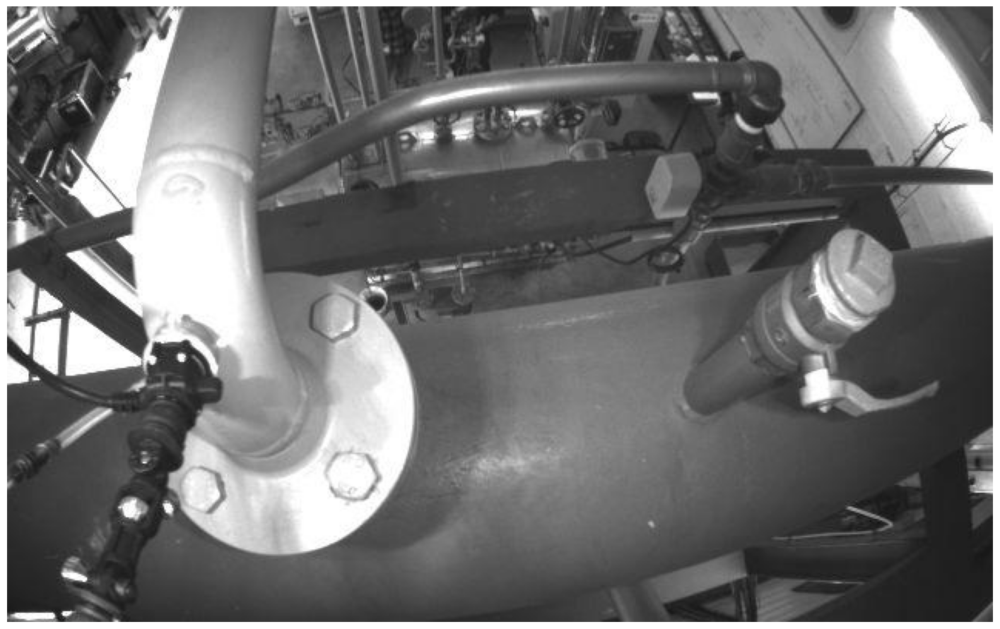


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_300_2.jpg: 416x640 1 probe, 221.8ms
Speed: 2.5ms preprocess, 221.8ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


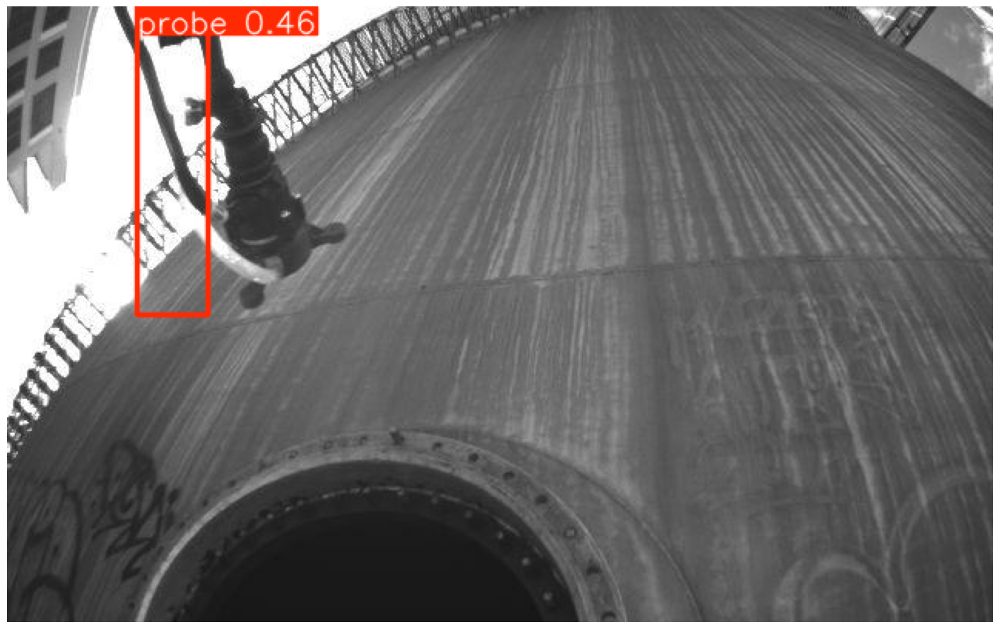


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_8700_2.jpg: 416x640 1 probe, 309.3ms
Speed: 6.7ms preprocess, 309.3ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)


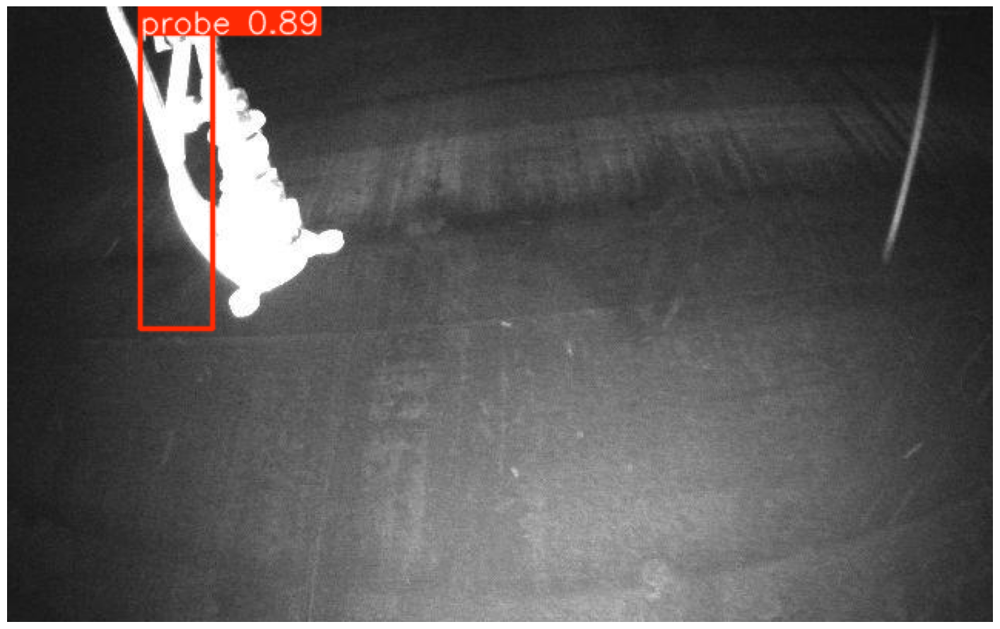


image 1/1 /content/data/test/images/E300SA23130257_00301_214_1flight_900_0.jpg: 416x640 1 probe, 251.3ms
Speed: 2.5ms preprocess, 251.3ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)


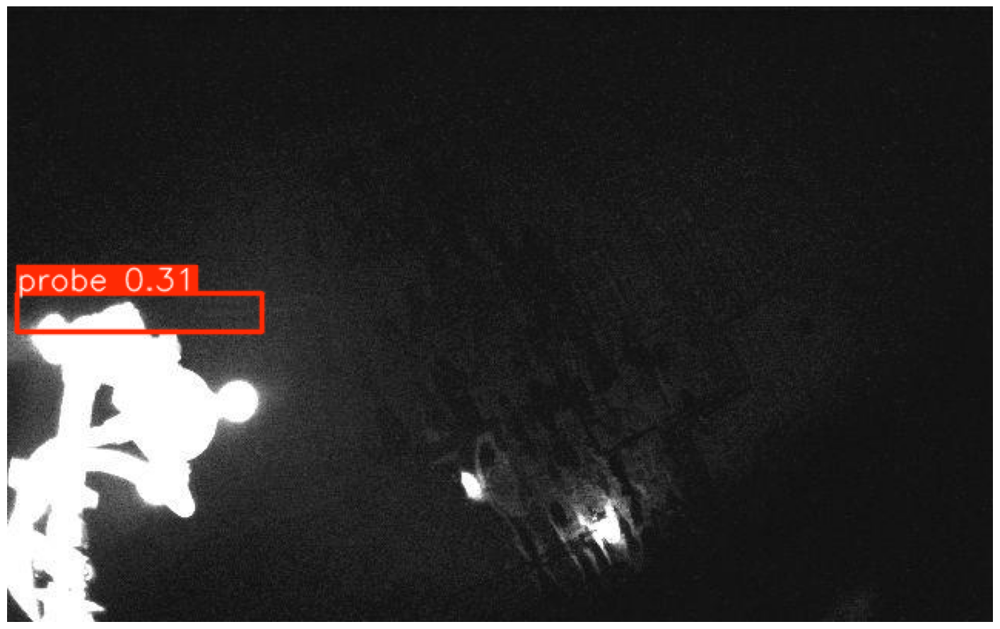


image 1/1 /content/data/test/images/EL300858804493_00188_043_1flight_3000_0.jpg: 416x640 1 probe, 265.2ms
Speed: 2.5ms preprocess, 265.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 640)


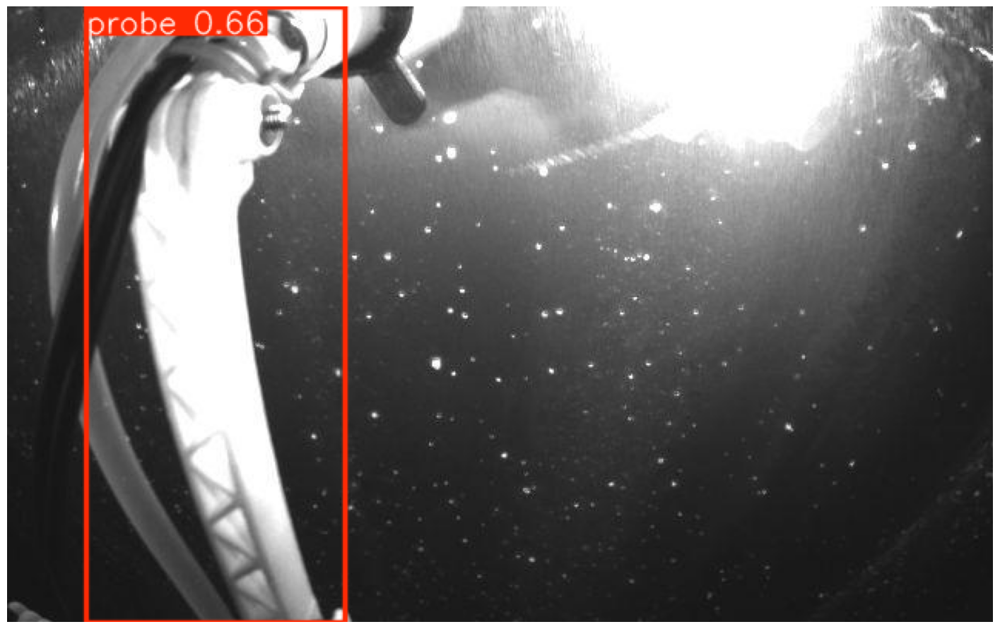


image 1/1 /content/data/test/images/E300SA22440035_01533_862_1flight_6300_0.jpg: 416x640 (no detections), 279.9ms
Speed: 2.5ms preprocess, 279.9ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


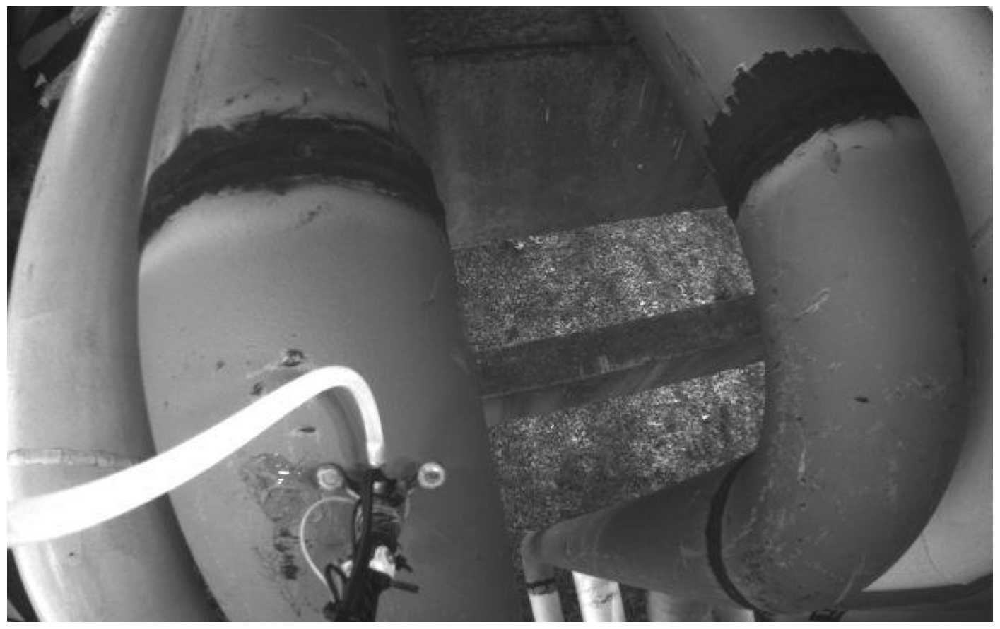


image 1/1 /content/data/test/images/E300SA23130257_00057_043_1flight_8100_0.jpg: 416x640 1 probe, 244.5ms
Speed: 5.8ms preprocess, 244.5ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)


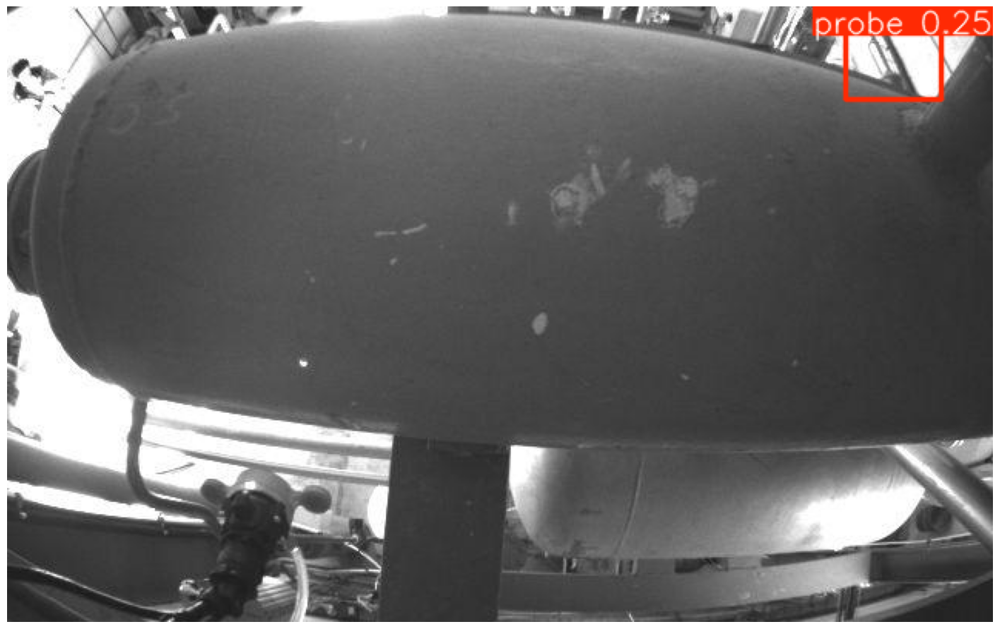


image 1/1 /content/data/test/images/E300SA22440035_01510_843_1flight_10500_0.jpg: 416x640 (no detections), 585.3ms
Speed: 7.7ms preprocess, 585.3ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


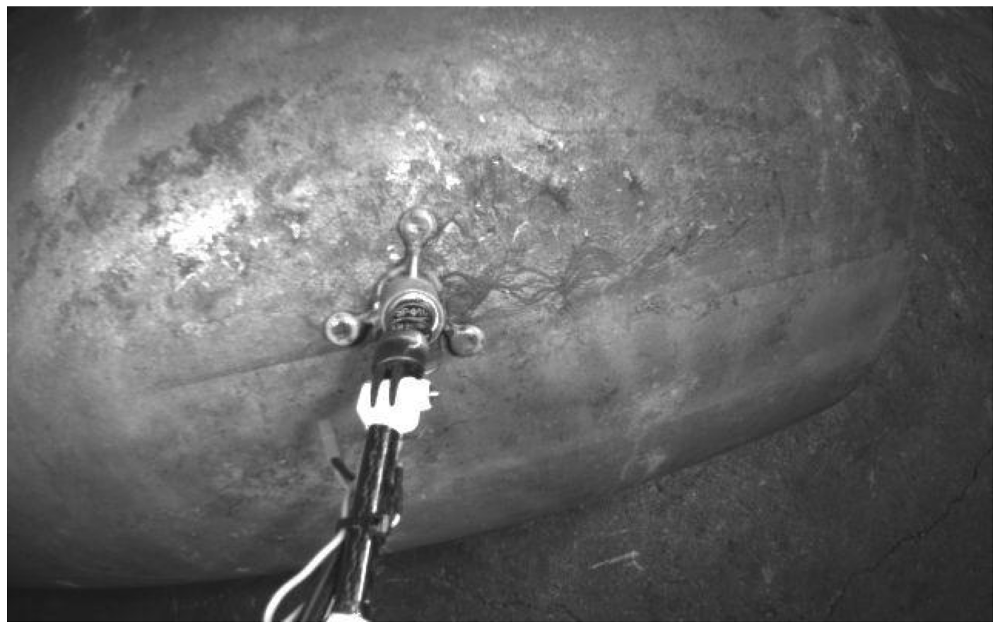


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_6300_2.jpg: 416x640 1 probe, 542.3ms
Speed: 2.5ms preprocess, 542.3ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


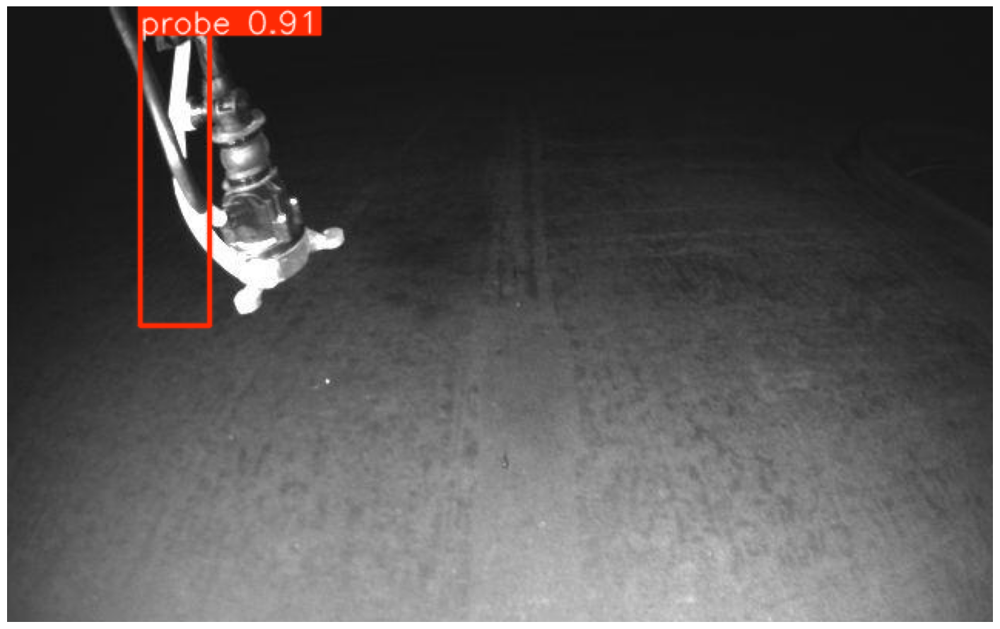


image 1/1 /content/data/test/images/E300SA22440034_00451_135_1flight_2100_2.jpg: 416x640 1 probe, 435.5ms
Speed: 11.4ms preprocess, 435.5ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


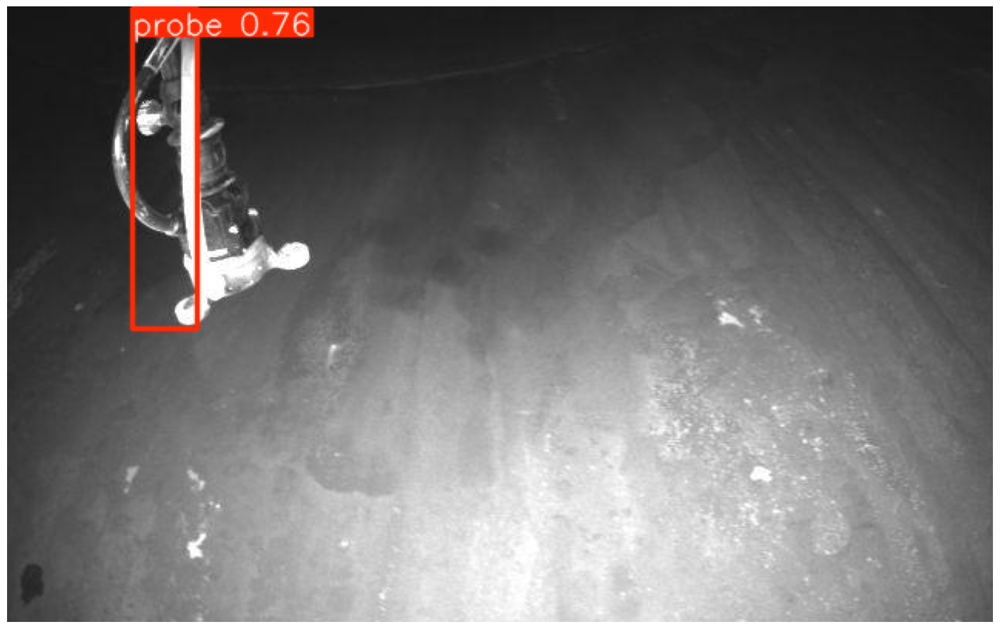


image 1/1 /content/data/test/images/EL300858804493_00193_048_1flight_1500_0.jpg: 416x640 1 probe, 576.6ms
Speed: 3.2ms preprocess, 576.6ms inference, 4.3ms postprocess per image at shape (1, 3, 416, 640)


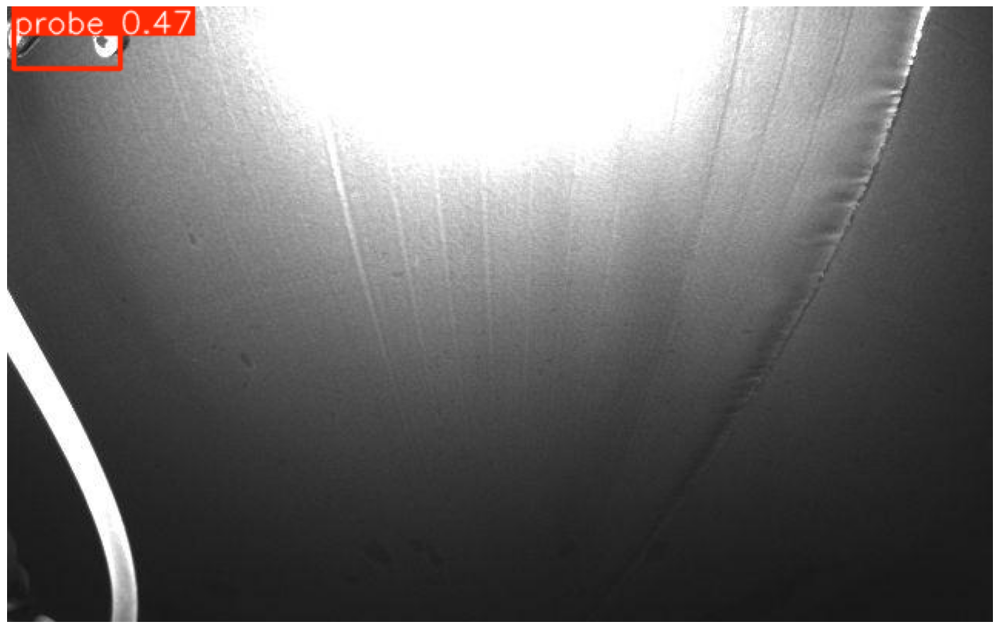

KeyboardInterrupt: 

In [ ]:
from ultralytics import YOLO
import  cv2
import cvzone
import math
import matplotlib.pyplot as plt

classNames = ["probe"]
for img in os.listdir(test_path) :
  results = model.predict(test_path + '/' + img)
  imag = results[0].plot()
  plt.figure(figsize=(5,5))
  plt.imshow(imag)
  plt.axis('off')
  plt.show()


### Model train using Yolo 8 medium

In [ ]:
from ultralytics import YOLO

# Load a model
model_m = YOLO("yolov8m.yaml")  # build a new model from YAML
model_m = YOLO("yolov8m.pt")  # load a pretrained model (recommended for training)
model_m = YOLO("yolov8m.yaml").load("yolov8m.pt")  # build from YAML and transfer weights

# Train the model
results_m = model_m.train(data="/content/data/data.yaml", epochs=40)

Transferred 475/475 items from pretrained weights
Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.yaml, data=/content/data/data.yaml, epochs=40, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=yolov8m.pt, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_

train: Scanning /content/data/train/labels.cache... 249 images, 0 backgrounds, 0 corrupt: 100%|██████████| 249/249 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/data/val/labels.cache... 28 images, 0 backgrounds, 0 corrupt: 100%|██████████| 28/28 [00:00<?, ?it/s]


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train3
Starting training for 40 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/40       7.2G      2.873      4.439      2.551         21        640: 100%|██████████| 16/16 [00:09<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.00it/s]

                   all         28         28    0.00369      0.143     0.0024   0.000864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/40      6.79G      2.133      3.098      1.834         15        640: 100%|██████████| 16/16 [00:08<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.95it/s]

                   all         28         28   0.000476      0.143   0.000299   0.000116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/40      6.83G      2.154      3.002      1.869         12        640: 100%|██████████| 16/16 [00:09<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.72it/s]

                   all         28         28   0.000993      0.179   0.000711   0.000275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/40      6.82G      2.278      2.955      1.964         12        640: 100%|██████████| 16/16 [00:08<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.81it/s]

                   all         28         28    0.00163      0.464    0.00176   0.000647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/40      6.81G      2.285        2.9      1.968         22        640: 100%|██████████| 16/16 [00:08<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.81it/s]

                   all         28         28    0.00115       0.25   0.000959   0.000263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/40      6.81G       2.21      2.923      1.955         15        640: 100%|██████████| 16/16 [00:08<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.36it/s]

                   all         28         28   0.000495      0.143   0.000285   0.000121



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/40      6.73G      2.172      2.833      1.927         20        640: 100%|██████████| 16/16 [00:08<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.73it/s]

                   all         28         28    0.00226      0.607    0.00201    0.00073



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/40      6.73G       2.29       2.88      2.018         16        640: 100%|██████████| 16/16 [00:08<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]

                   all         28         28    0.00523      0.107     0.0016   0.000477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/40      6.76G       2.21      2.617      1.941         12        640: 100%|██████████| 16/16 [00:08<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.74it/s]

                   all         28         28      0.197      0.179     0.0952     0.0323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/40      6.77G      2.193      2.788       1.97         16        640: 100%|██████████| 16/16 [00:08<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.40it/s]

                   all         28         28     0.0261      0.179     0.0109    0.00322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/40      6.73G      2.098      2.631       1.83         12        640: 100%|██████████| 16/16 [00:08<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.55it/s]

                   all         28         28      0.447      0.231       0.19      0.101



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/40      6.73G      2.051      2.552      1.797         19        640: 100%|██████████| 16/16 [00:08<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.71it/s]

                   all         28         28     0.0104     0.0357    0.00623    0.00156



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/40      6.72G        2.1      2.576      1.844         18        640: 100%|██████████| 16/16 [00:08<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.63it/s]

                   all         28         28      0.479      0.429      0.311       0.14



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/40      6.76G      1.991       2.59      1.817         23        640: 100%|██████████| 16/16 [00:08<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.00it/s]

                   all         28         28      0.506      0.286      0.295      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/40      6.78G      1.985      2.475      1.803         22        640: 100%|██████████| 16/16 [00:08<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.21it/s]

                   all         28         28      0.362      0.393      0.269      0.131



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/40      6.76G      1.939      2.396       1.71         19        640: 100%|██████████| 16/16 [00:08<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]

                   all         28         28     0.0231       0.25     0.0127    0.00764



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/40      6.78G       1.84      2.349      1.708         21        640: 100%|██████████| 16/16 [00:08<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.79it/s]

                   all         28         28      0.687      0.393      0.387      0.284



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/40      6.73G      1.845      2.297      1.678         17        640: 100%|██████████| 16/16 [00:08<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.35it/s]

                   all         28         28      0.869      0.393      0.398      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/40      6.76G      1.737      2.192      1.636         15        640: 100%|██████████| 16/16 [00:08<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]

                   all         28         28      0.844      0.386      0.426       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/40      6.77G      1.852      2.195       1.67         13        640: 100%|██████████| 16/16 [00:08<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.77it/s]

                   all         28         28      0.919      0.357       0.43       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/40      6.76G      1.817      2.236      1.689         15        640: 100%|██████████| 16/16 [00:08<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.78it/s]

                   all         28         28      0.745      0.393      0.384      0.285



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/40      6.78G      1.741      2.107      1.658         19        640: 100%|██████████| 16/16 [00:08<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.13it/s]

                   all         28         28        0.9      0.393      0.414       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/40      6.77G       1.65       1.91       1.55         16        640: 100%|██████████| 16/16 [00:08<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.60it/s]

                   all         28         28      0.986      0.393      0.439       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/40      6.73G      1.631      2.037      1.608         20        640: 100%|██████████| 16/16 [00:08<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.11it/s]

                   all         28         28      0.905      0.429      0.449      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/40      6.78G      1.593      1.915      1.543         20        640: 100%|██████████| 16/16 [00:08<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.06it/s]

                   all         28         28      0.886      0.464      0.486      0.355



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/40      6.73G      1.488      1.783      1.521         16        640: 100%|██████████| 16/16 [00:08<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.33it/s]

                   all         28         28       0.99      0.429      0.496      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/40      6.73G      1.518      1.728      1.482         14        640: 100%|██████████| 16/16 [00:08<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.30it/s]

                   all         28         28      0.903      0.429      0.489      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/40      6.76G      1.511      1.752      1.496         15        640: 100%|██████████| 16/16 [00:08<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.22it/s]

                   all         28         28      0.988      0.429      0.519      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/40      6.77G      1.422      1.678      1.471         18        640: 100%|██████████| 16/16 [00:08<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all         28         28      0.919      0.429      0.482      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/40      6.73G      1.435      1.684      1.462         21        640: 100%|██████████| 16/16 [00:08<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.25it/s]

                   all         28         28      0.987      0.464      0.524      0.367


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/40      6.73G      1.387      1.747      1.492          9        640: 100%|██████████| 16/16 [00:09<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.58it/s]

                   all         28         28      0.987      0.429      0.527      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/40      6.73G      1.362      1.668      1.459          9        640: 100%|██████████| 16/16 [00:08<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.94it/s]

                   all         28         28      0.989      0.429      0.493      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/40      6.78G      1.277      1.439      1.396          9        640: 100%|██████████| 16/16 [00:08<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.85it/s]

                   all         28         28      0.992      0.429      0.503       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/40      6.73G      1.316      1.519       1.42          8        640: 100%|██████████| 16/16 [00:08<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.56it/s]

                   all         28         28      0.988      0.429      0.515      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/40      6.76G      1.249      1.451       1.42          7        640: 100%|██████████| 16/16 [00:08<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.90it/s]

                   all         28         28      0.999      0.464      0.539      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/40      6.78G      1.195      1.276      1.378          9        640: 100%|██████████| 16/16 [00:08<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]

                   all         28         28          1      0.495      0.571      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/40      6.76G      1.303      1.327      1.419          9        640: 100%|██████████| 16/16 [00:08<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]

                   all         28         28          1      0.494      0.579       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/40      6.78G      1.204      1.278      1.381          9        640: 100%|██████████| 16/16 [00:08<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.84it/s]

                   all         28         28          1      0.458      0.574      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/40      6.76G      1.186      1.191      1.352          9        640: 100%|██████████| 16/16 [00:08<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.83it/s]

                   all         28         28       0.98      0.429      0.547      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/40      6.76G      1.133      1.217      1.321          9        640: 100%|██████████| 16/16 [00:08<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all         28         28          1      0.458      0.551      0.434



40 epochs completed in 0.167 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 52.0MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8m summary (fused): 218 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]


                   all         28         28          1      0.458      0.574      0.456
Speed: 0.2ms preprocess, 6.2ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train3



image 1/1 /content/data/test/images/E300SA22440035_01533_862_1flight_6300_0.jpg: 416x640 3 probes, 28.2ms
Speed: 2.5ms preprocess, 28.2ms inference, 2.2ms postprocess per image at shape (1, 3, 416, 640)


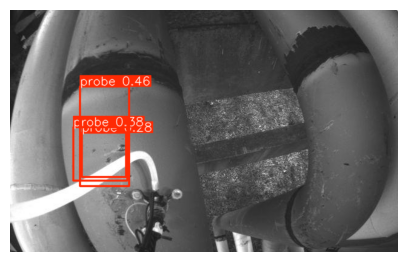


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_8700_2.jpg: 416x640 1 probe, 32.6ms
Speed: 1.6ms preprocess, 32.6ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


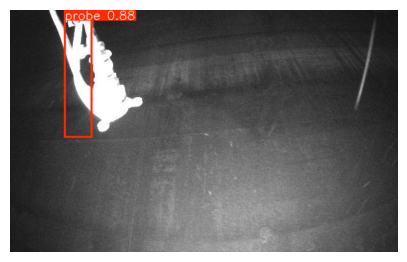


image 1/1 /content/data/test/images/EL300858804493_00188_043_1flight_3000_0.jpg: 416x640 (no detections), 32.0ms
Speed: 2.7ms preprocess, 32.0ms inference, 2.8ms postprocess per image at shape (1, 3, 416, 640)


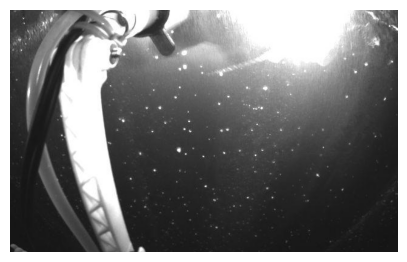


image 1/1 /content/data/test/images/EL300858804493_00330_112_1flight_9600_2.jpg: 416x640 (no detections), 32.9ms
Speed: 2.9ms preprocess, 32.9ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)


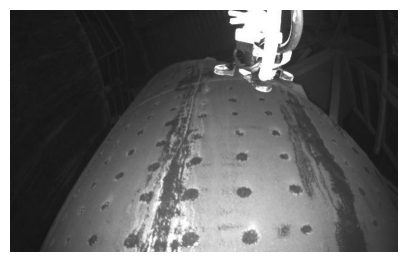


image 1/1 /content/data/test/images/E300SA23130257_00057_043_1flight_8100_0.jpg: 416x640 1 probe, 29.0ms
Speed: 1.7ms preprocess, 29.0ms inference, 2.1ms postprocess per image at shape (1, 3, 416, 640)


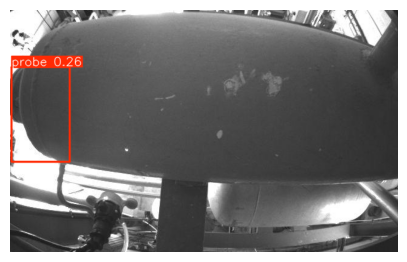


image 1/1 /content/data/test/images/EL300858804493_00184_039_1flight_9300_2.jpg: 416x640 1 probe, 35.1ms
Speed: 1.6ms preprocess, 35.1ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


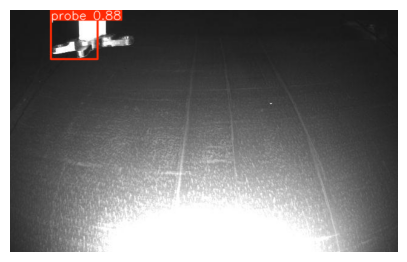


image 1/1 /content/data/test/images/E300SA22440034_00452_136_1flight_2100_2.jpg: 416x640 1 probe, 31.4ms
Speed: 1.7ms preprocess, 31.4ms inference, 4.7ms postprocess per image at shape (1, 3, 416, 640)


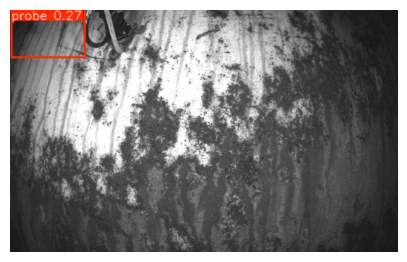


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_900_2.jpg: 416x640 1 probe, 30.2ms
Speed: 1.8ms preprocess, 30.2ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


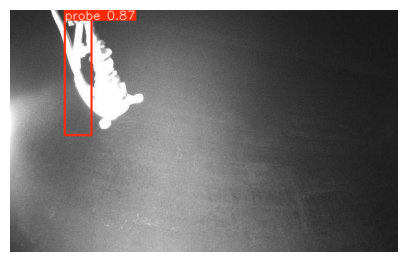


image 1/1 /content/data/test/images/E300SA23130257_00295_209_1flight_0_2.jpg: 416x640 1 probe, 35.9ms
Speed: 1.6ms preprocess, 35.9ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


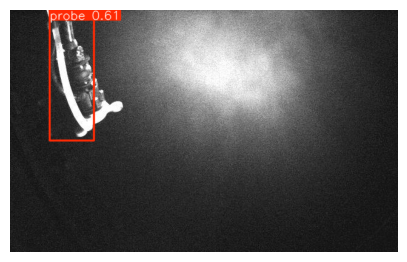


image 1/1 /content/data/test/images/EL300858804493_00193_048_1flight_1500_0.jpg: 416x640 1 probe, 27.0ms
Speed: 1.6ms preprocess, 27.0ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)


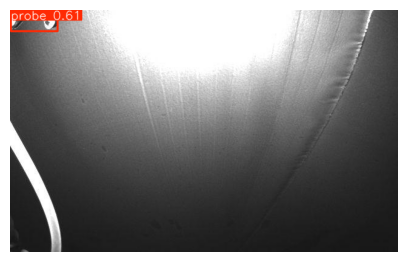


image 1/1 /content/data/test/images/E300SA23130257_00301_214_1flight_900_0.jpg: 416x640 (no detections), 27.0ms
Speed: 1.6ms preprocess, 27.0ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)


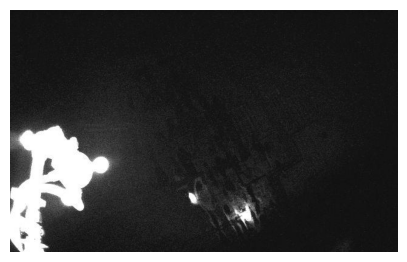


image 1/1 /content/data/test/images/EL300858804493_00330_112_1flight_2400_2.jpg: 416x640 (no detections), 27.0ms
Speed: 1.7ms preprocess, 27.0ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


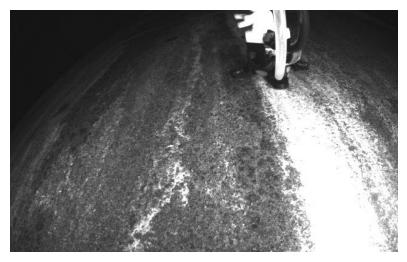


image 1/1 /content/data/test/images/E300SA23130257_00054_035_1flight_1200_0.jpg: 416x640 (no detections), 26.9ms
Speed: 1.6ms preprocess, 26.9ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)


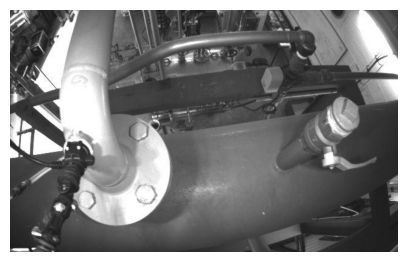


image 1/1 /content/data/test/images/EL300858804493_00184_039_1flight_3300_2.jpg: 416x640 2 probes, 27.0ms
Speed: 1.8ms preprocess, 27.0ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


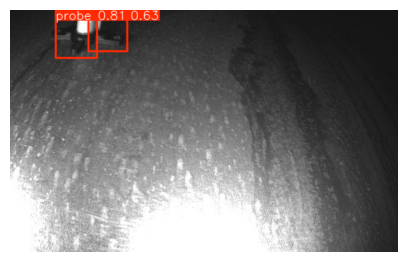


image 1/1 /content/data/test/images/E300SA22440034_00451_135_1flight_3000_2.jpg: 416x640 1 probe, 26.9ms
Speed: 1.8ms preprocess, 26.9ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


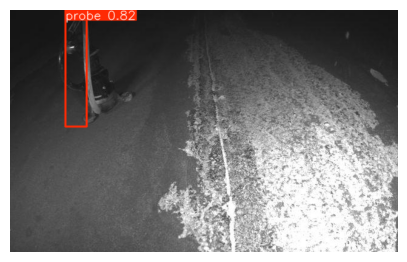


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_3900_2.jpg: 416x640 1 probe, 26.9ms
Speed: 1.6ms preprocess, 26.9ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


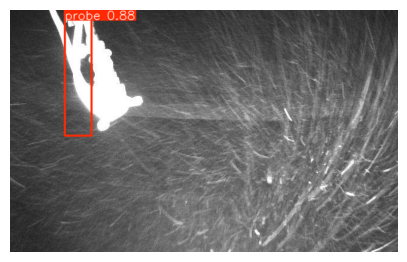


image 1/1 /content/data/test/images/E300SA22440034_00465_143_1flight_1800_2.jpg: 416x640 1 probe, 27.0ms
Speed: 1.7ms preprocess, 27.0ms inference, 7.5ms postprocess per image at shape (1, 3, 416, 640)


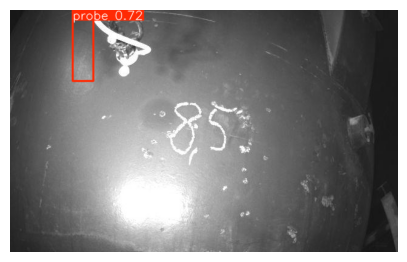


image 1/1 /content/data/test/images/E300SA22440034_00447_133_1flight_8400_2.jpg: 416x640 1 probe, 30.5ms
Speed: 1.6ms preprocess, 30.5ms inference, 4.0ms postprocess per image at shape (1, 3, 416, 640)


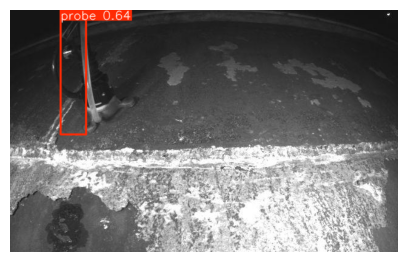


image 1/1 /content/data/test/images/E300SA23130257_00057_043_1flight_11700_0.jpg: 416x640 (no detections), 31.1ms
Speed: 1.6ms preprocess, 31.1ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


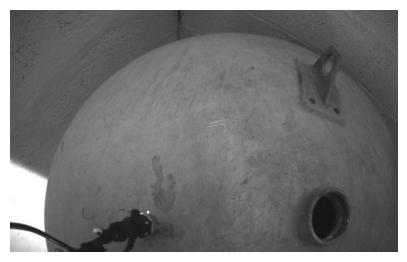


image 1/1 /content/data/test/images/E300SA22440034_00447_133_1flight_9000_2.jpg: 416x640 1 probe, 29.1ms
Speed: 1.5ms preprocess, 29.1ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)


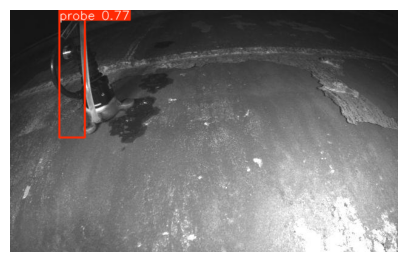


image 1/1 /content/data/test/images/E300SA23130257_00060_045_1flight_900_0.jpg: 416x640 (no detections), 28.2ms
Speed: 1.5ms preprocess, 28.2ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


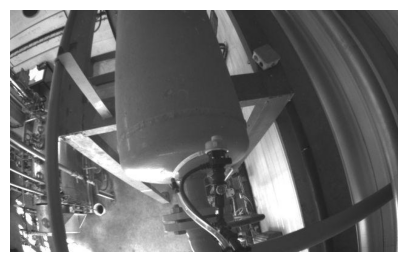


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_300_2.jpg: 416x640 1 probe, 28.6ms
Speed: 1.5ms preprocess, 28.6ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


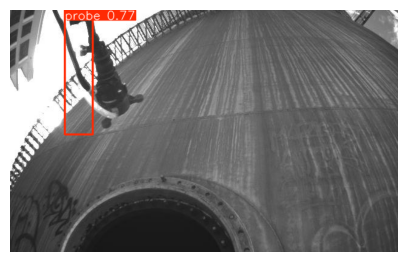


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_9300_2.jpg: 416x640 1 probe, 27.0ms
Speed: 1.6ms preprocess, 27.0ms inference, 2.7ms postprocess per image at shape (1, 3, 416, 640)


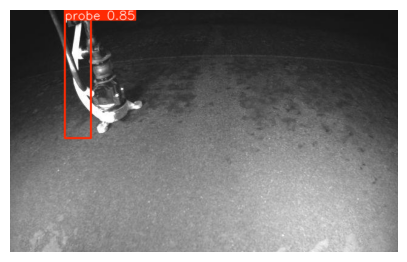


image 1/1 /content/data/test/images/E300SA22440035_01533_862_1flight_1500_0.jpg: 416x640 1 probe, 27.0ms
Speed: 1.6ms preprocess, 27.0ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)


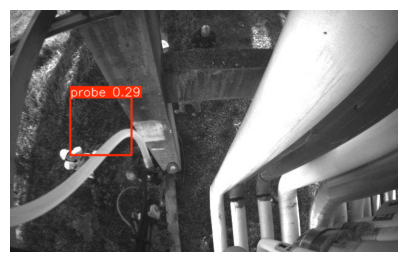


image 1/1 /content/data/test/images/E300SA22440034_00451_135_1flight_2100_2.jpg: 416x640 1 probe, 26.9ms
Speed: 1.5ms preprocess, 26.9ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)


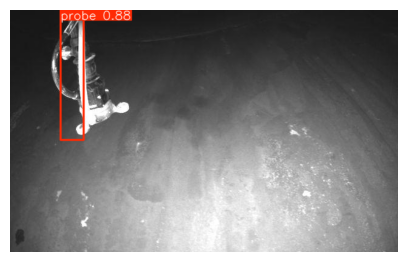


image 1/1 /content/data/test/images/E300SA22440035_01510_843_1flight_10500_0.jpg: 416x640 (no detections), 27.0ms
Speed: 1.7ms preprocess, 27.0ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


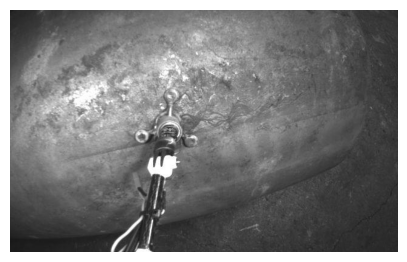


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_6300_2.jpg: 416x640 1 probe, 29.4ms
Speed: 1.6ms preprocess, 29.4ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


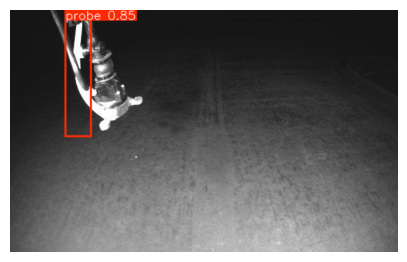


image 1/1 /content/data/test/images/E300SA23130257_00295_209_1flight_11100_2.jpg: 416x640 1 probe, 29.0ms
Speed: 1.6ms preprocess, 29.0ms inference, 3.7ms postprocess per image at shape (1, 3, 416, 640)


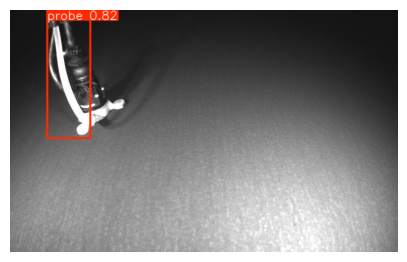


image 1/1 /content/data/test/images/E300SA23130257_00053_034_1flight_1800_0.jpg: 416x640 2 probes, 27.5ms
Speed: 1.8ms preprocess, 27.5ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


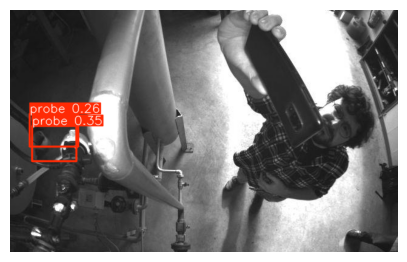


image 1/1 /content/data/test/images/E300SA23130257_00267_199_1flight_6000_2.jpg: 416x640 1 probe, 29.6ms
Speed: 1.8ms preprocess, 29.6ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)


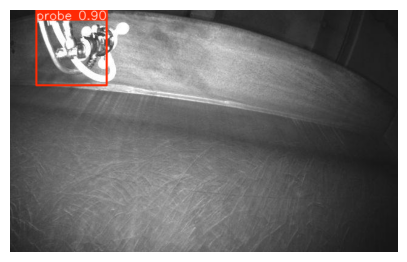


image 1/1 /content/data/test/images/E300SA23130257_00053_033_1flight_3900_0.jpg: 416x640 (no detections), 28.8ms
Speed: 1.4ms preprocess, 28.8ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)


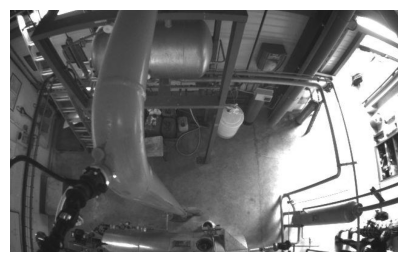

In [ ]:
from ultralytics import YOLO
import  cv2
import cvzone
import math
import matplotlib.pyplot as plt

classNames = ["probe"]
for img in os.listdir(test_path) :
  results = model_m.predict(test_path + '/' + img)
  imag = results[0].plot()
  plt.figure(figsize=(5,5))
  plt.imshow(imag)
  plt.axis('off')
  plt.show()

### Model train using Yolo 8 medium with batch size and Learning rate change.
### BEST MODEL***

In [ ]:
from ultralytics import YOLO

# Load a model
model_m2 = YOLO("yolov8m.yaml")  # build a new model from YAML
model_m2 = YOLO("yolov8m.pt")  # load a pretrained model (recommended for training)
model_m2 = YOLO("yolov8m.yaml").load("yolov8m.pt")  # build from YAML and transfer weights

# Train the model
results_m2 = model_m2.train(data="/content/data/data.yaml", epochs=50, batch=4, lr0 = 0.0001)

Transferred 475/475 items from pretrained weights
Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.yaml, data=/content/data/data.yaml, epochs=50, time=None, patience=100, batch=4, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train4, exist_ok=False, pretrained=yolov8m.pt, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_c

train: Scanning /content/data/train/labels.cache... 249 images, 0 backgrounds, 0 corrupt: 100%|██████████| 249/249 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/data/val/labels.cache... 28 images, 0 backgrounds, 0 corrupt: 100%|██████████| 28/28 [00:00<?, ?it/s]


Plotting labels to runs/detect/train4/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train4
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.93G      2.618      4.124      2.311          1        640: 100%|██████████| 63/63 [00:13<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.12it/s]

                   all         28         28     0.0223     0.0357    0.00806    0.00158



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.77G      2.718      3.656      2.354          2        640: 100%|██████████| 63/63 [00:12<00:00,  5.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.19it/s]

                   all         28         28    0.00915      0.143     0.0031   0.000628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.77G       2.72      3.528      2.492          2        640: 100%|██████████| 63/63 [00:11<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.02it/s]


                   all         28         28    0.00332      0.464    0.00236    0.00126

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.76G      2.967      3.705      2.602          1        640: 100%|██████████| 63/63 [00:10<00:00,  6.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.90it/s]

                   all         28         28   0.000633      0.107   0.000424   0.000176



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.76G      2.693       3.52      2.392          0        640: 100%|██████████| 63/63 [00:10<00:00,  5.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.75it/s]

                   all         28         28   0.000368      0.107   0.000206   5.42e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50       2.7G      2.574      3.465      2.328          4        640: 100%|██████████| 63/63 [00:10<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 13.41it/s]

                   all         28         28      0.118     0.0357     0.0267    0.00532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50       2.7G      2.523      3.289      2.294          4        640: 100%|██████████| 63/63 [00:12<00:00,  4.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 13.04it/s]

                   all         28         28      0.243      0.321      0.123     0.0715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50       2.7G      2.545       3.29      2.276          4        640: 100%|██████████| 63/63 [00:12<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 12.58it/s]

                   all         28         28      0.207      0.187      0.115     0.0482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50       2.7G      2.426       3.19       2.23          2        640: 100%|██████████| 63/63 [00:12<00:00,  4.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 13.10it/s]

                   all         28         28      0.149      0.179     0.0801     0.0242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.71G      2.451      3.124      2.235          2        640: 100%|██████████| 63/63 [00:12<00:00,  4.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 11.27it/s]

                   all         28         28     0.0744      0.214     0.0347     0.0119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50       2.7G      2.494      3.154      2.213          4        640: 100%|██████████| 63/63 [00:10<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.34it/s]


                   all         28         28     0.0369       0.25     0.0191    0.00929

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50       2.7G      2.318      2.953      2.078          3        640: 100%|██████████| 63/63 [00:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 12.99it/s]

                   all         28         28      0.311      0.286      0.208      0.126



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.78G      2.335      3.042      2.123          1        640: 100%|██████████| 63/63 [00:11<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.49it/s]

                   all         28         28      0.387      0.339      0.204      0.106



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.68G      2.224      2.936      2.028          4        640: 100%|██████████| 63/63 [00:10<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.31it/s]

                   all         28         28      0.516      0.267      0.269      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.77G      2.179      3.041      2.033          2        640: 100%|██████████| 63/63 [00:11<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 13.15it/s]

                   all         28         28      0.437      0.286      0.233       0.15



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50       2.7G      2.338      2.956      2.116          1        640: 100%|██████████| 63/63 [00:11<00:00,  5.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 13.29it/s]

                   all         28         28      0.361      0.321       0.24      0.133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.76G      2.153      2.942       2.05          1        640: 100%|██████████| 63/63 [00:13<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 13.05it/s]

                   all         28         28      0.239      0.214      0.124     0.0755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.71G       2.17      2.897      2.044          2        640: 100%|██████████| 63/63 [00:10<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.51it/s]

                   all         28         28      0.489      0.214      0.276      0.144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.71G      2.102      2.753      1.972          2        640: 100%|██████████| 63/63 [00:11<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 13.18it/s]

                   all         28         28      0.423      0.321      0.289      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.71G      2.093      2.778      1.971          2        640: 100%|██████████| 63/63 [00:10<00:00,  6.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.17it/s]

                   all         28         28      0.601      0.393      0.363      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.71G      2.078       2.68      1.944          1        640: 100%|██████████| 63/63 [00:10<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.01it/s]

                   all         28         28      0.675      0.297      0.344      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.71G      2.157      2.774       2.08          1        640: 100%|██████████| 63/63 [00:11<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.25it/s]


                   all         28         28      0.909      0.355      0.378      0.234

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.71G      2.072       2.57      1.984          1        640: 100%|██████████| 63/63 [00:11<00:00,  5.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.94it/s]

                   all         28         28      0.733      0.321      0.376      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50       2.7G      1.935      2.493      1.861          2        640: 100%|██████████| 63/63 [00:10<00:00,  5.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.65it/s]

                   all         28         28      0.481      0.357      0.279      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50       2.7G      1.903      2.507      1.832          1        640: 100%|██████████| 63/63 [00:10<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.33it/s]

                   all         28         28      0.674      0.321      0.355      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.71G      1.914      2.522      1.838          1        640: 100%|██████████| 63/63 [00:11<00:00,  5.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.98it/s]

                   all         28         28       0.48      0.429       0.38      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.71G      1.892      2.441      1.845          2        640: 100%|██████████| 63/63 [00:11<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 13.11it/s]

                   all         28         28      0.709      0.429       0.44      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.69G      1.872      2.465      1.823          4        640: 100%|██████████| 63/63 [00:13<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 12.49it/s]

                   all         28         28      0.935      0.393      0.434      0.296



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.77G      1.863      2.432      1.829          1        640: 100%|██████████| 63/63 [00:12<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.55it/s]

                   all         28         28       0.69      0.429      0.413      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.71G      1.893      2.472      1.834          1        640: 100%|██████████| 63/63 [00:10<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.44it/s]

                   all         28         28      0.749      0.426      0.435      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.76G      1.727      2.222      1.687          4        640: 100%|██████████| 63/63 [00:11<00:00,  5.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.85it/s]

                   all         28         28      0.885      0.429      0.454      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.71G      1.745      2.312      1.752          2        640: 100%|██████████| 63/63 [00:10<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.35it/s]

                   all         28         28      0.979      0.429      0.514      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50       2.7G      1.831      2.352      1.794          2        640: 100%|██████████| 63/63 [00:11<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 12.98it/s]

                   all         28         28      0.882      0.429      0.499      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.71G      1.726      2.176      1.712          3        640: 100%|██████████| 63/63 [00:12<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.34it/s]

                   all         28         28      0.721      0.393      0.445      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.71G      1.751      2.221      1.745          2        640: 100%|██████████| 63/63 [00:10<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.33it/s]


                   all         28         28      0.868        0.5      0.546      0.416

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.71G      1.814      2.372      1.797          2        640: 100%|██████████| 63/63 [00:11<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.52it/s]

                   all         28         28      0.887      0.464       0.54      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50       2.7G      1.551      1.945      1.591          3        640: 100%|██████████| 63/63 [00:10<00:00,  5.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 12.22it/s]

                   all         28         28      0.783        0.5      0.547      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.71G      1.609      2.048      1.667          0        640: 100%|██████████| 63/63 [00:12<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.54it/s]

                   all         28         28      0.734      0.536      0.536      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.71G      1.673      2.101      1.691          2        640: 100%|██████████| 63/63 [00:12<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.75it/s]

                   all         28         28       0.67      0.508      0.499      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50       2.7G      1.572      1.963      1.633          2        640: 100%|██████████| 63/63 [00:12<00:00,  5.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.17it/s]


                   all         28         28      0.815        0.5      0.542      0.428
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.71G       1.59      2.014      1.675          1        640: 100%|██████████| 63/63 [00:12<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.01it/s]

                   all         28         28      0.762      0.571      0.569      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.71G      1.577      2.008      1.669          1        640: 100%|██████████| 63/63 [00:12<00:00,  4.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.28it/s]

                   all         28         28      0.797      0.571      0.555      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.77G      1.536       1.87      1.661          1        640: 100%|██████████| 63/63 [00:12<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.48it/s]

                   all         28         28      0.867      0.536      0.569      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50       2.7G      1.402      1.741      1.591          1        640: 100%|██████████| 63/63 [00:12<00:00,  4.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 13.04it/s]

                   all         28         28      0.937       0.53      0.573      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.77G       1.46      1.778      1.634          1        640: 100%|██████████| 63/63 [00:13<00:00,  4.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 12.68it/s]

                   all         28         28       0.83      0.571      0.579      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.71G      1.477      1.838      1.576          1        640: 100%|██████████| 63/63 [00:10<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.19it/s]

                   all         28         28      0.918        0.5      0.561       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.76G      1.339      1.648      1.549          1        640: 100%|██████████| 63/63 [00:11<00:00,  5.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.50it/s]

                   all         28         28          1      0.527       0.57      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.71G      1.386       1.68      1.547          1        640: 100%|██████████| 63/63 [00:11<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.74it/s]


                   all         28         28          1      0.535      0.575      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.77G      1.358      1.587      1.546          1        640: 100%|██████████| 63/63 [00:10<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 10.29it/s]

                   all         28         28      0.985      0.536      0.578      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50       2.7G       1.37      1.626      1.553          1        640: 100%|██████████| 63/63 [00:11<00:00,  5.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00, 13.36it/s]

                   all         28         28      0.984      0.536      0.577      0.462



50 epochs completed in 0.235 hours.
Optimizer stripped from runs/detect/train4/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train4/weights/best.pt, 52.0MB

Validating runs/detect/train4/weights/best.pt...
Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8m summary (fused): 218 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.89it/s]


                   all         28         28      0.937       0.53      0.573      0.479
Speed: 0.2ms preprocess, 14.7ms inference, 0.0ms loss, 4.6ms postprocess per image
Results saved to runs/detect/train4


In [ ]:
# from ultralytics import YOLO
# import  cv2
# import cvzone
# import math
# import matplotlib.pyplot as plt

# classNames = ["probe"]
# for img in os.listdir(test_path) :
#   results = model_m2.predict(test_path + '/' + img)
#   imag = results[0].plot()
#   plt.figure(figsize=(5,5))
#   plt.imshow(imag)
#   plt.axis('off')
#   plt.show()

### Predict using saved model


image 1/1 /content/probe_test_images/E300SA22440035_01533_862_1flight_6300_0.jpg: 416x640 (no detections), 98.2ms
Speed: 5.0ms preprocess, 98.2ms inference, 87.3ms postprocess per image at shape (1, 3, 416, 640)


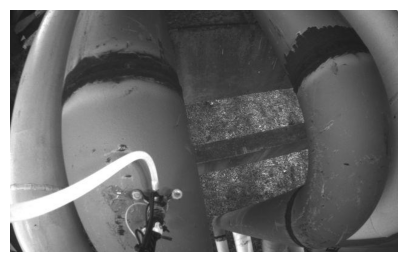


image 1/1 /content/probe_test_images/E300PREMP00002_00725_216_1flight_8700_2.jpg: 416x640 1 probe, 32.4ms
Speed: 4.1ms preprocess, 32.4ms inference, 644.0ms postprocess per image at shape (1, 3, 416, 640)


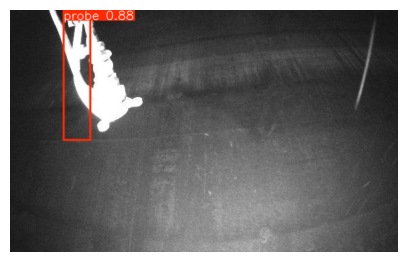


image 1/1 /content/probe_test_images/EL300858804493_00188_043_1flight_3000_0.jpg: 416x640 1 probe, 27.2ms
Speed: 2.1ms preprocess, 27.2ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


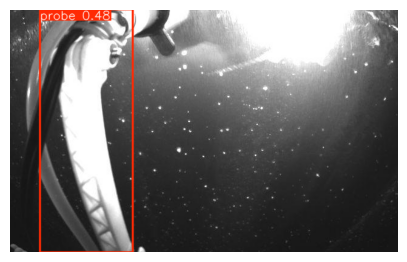


image 1/1 /content/probe_test_images/EL300858804493_00330_112_1flight_9600_2.jpg: 416x640 (no detections), 28.8ms
Speed: 7.4ms preprocess, 28.8ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 640)


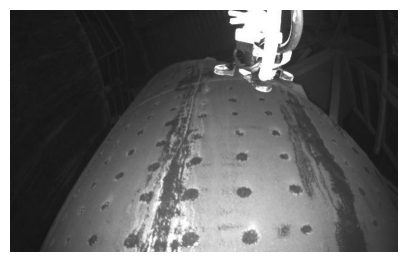


image 1/1 /content/probe_test_images/E300SA23130257_00057_043_1flight_8100_0.jpg: 416x640 (no detections), 28.7ms
Speed: 9.7ms preprocess, 28.7ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)


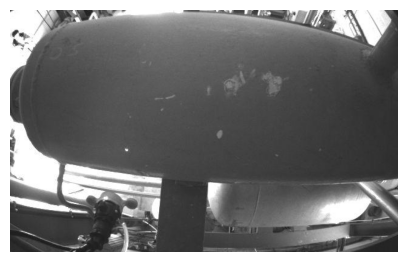


image 1/1 /content/probe_test_images/EL300858804493_00184_039_1flight_9300_2.jpg: 416x640 1 probe, 26.8ms
Speed: 1.4ms preprocess, 26.8ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


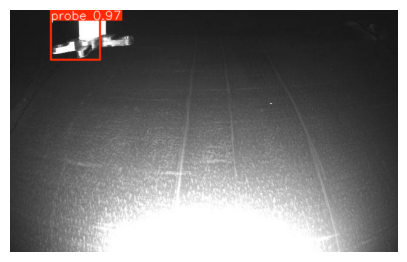


image 1/1 /content/probe_test_images/E300SA22440034_00452_136_1flight_2100_2.jpg: 416x640 (no detections), 31.4ms
Speed: 2.8ms preprocess, 31.4ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)


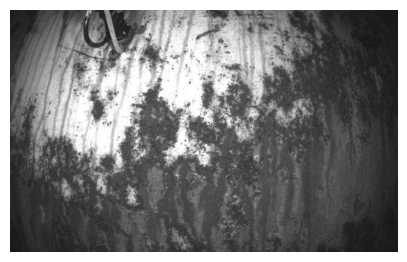


image 1/1 /content/probe_test_images/E300PREMP00002_00725_216_1flight_900_2.jpg: 416x640 1 probe, 29.5ms
Speed: 1.4ms preprocess, 29.5ms inference, 6.1ms postprocess per image at shape (1, 3, 416, 640)


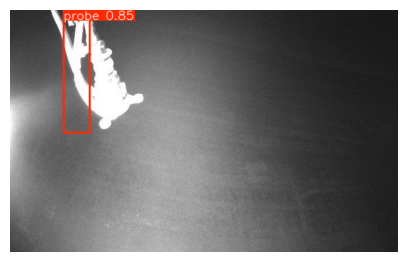


image 1/1 /content/probe_test_images/E300SA23130257_00295_209_1flight_0_2.jpg: 416x640 1 probe, 27.0ms
Speed: 2.2ms preprocess, 27.0ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


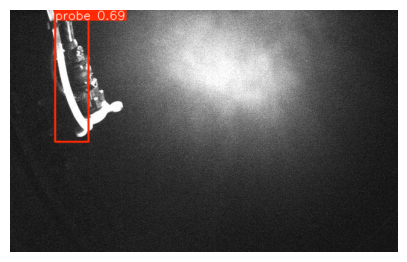


image 1/1 /content/probe_test_images/EL300858804493_00193_048_1flight_1500_0.jpg: 416x640 (no detections), 27.6ms
Speed: 1.5ms preprocess, 27.6ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 640)


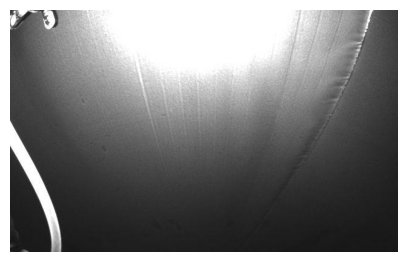


image 1/1 /content/probe_test_images/E300SA23130257_00301_214_1flight_900_0.jpg: 416x640 1 probe, 31.8ms
Speed: 1.5ms preprocess, 31.8ms inference, 2.6ms postprocess per image at shape (1, 3, 416, 640)


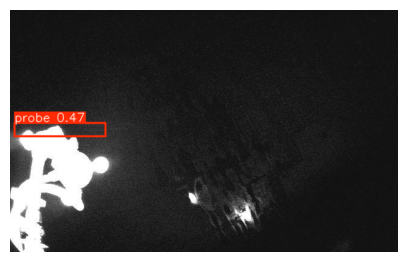


image 1/1 /content/probe_test_images/EL300858804493_00330_112_1flight_2400_2.jpg: 416x640 (no detections), 33.8ms
Speed: 1.4ms preprocess, 33.8ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)


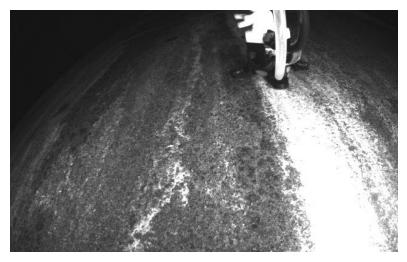


image 1/1 /content/probe_test_images/E300SA23130257_00054_035_1flight_1200_0.jpg: 416x640 (no detections), 26.9ms
Speed: 1.5ms preprocess, 26.9ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)


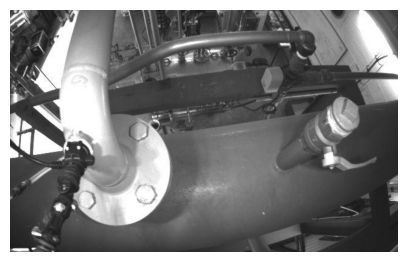


image 1/1 /content/probe_test_images/EL300858804493_00184_039_1flight_3300_2.jpg: 416x640 (no detections), 37.4ms
Speed: 1.5ms preprocess, 37.4ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


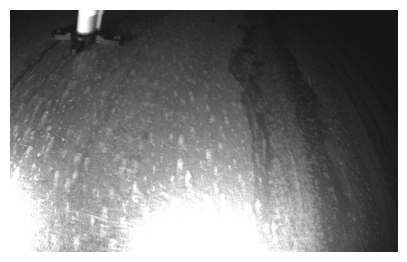


image 1/1 /content/probe_test_images/E300SA22440034_00451_135_1flight_3000_2.jpg: 416x640 1 probe, 33.6ms
Speed: 1.6ms preprocess, 33.6ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


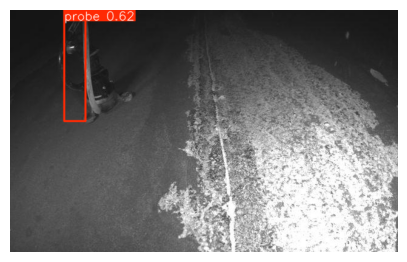


image 1/1 /content/probe_test_images/E300PREMP00002_00725_216_1flight_3900_2.jpg: 416x640 1 probe, 30.5ms
Speed: 2.3ms preprocess, 30.5ms inference, 6.1ms postprocess per image at shape (1, 3, 416, 640)


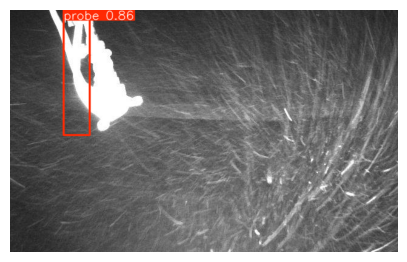


image 1/1 /content/probe_test_images/E300SA22440034_00465_143_1flight_1800_2.jpg: 416x640 2 probes, 26.9ms
Speed: 4.4ms preprocess, 26.9ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)


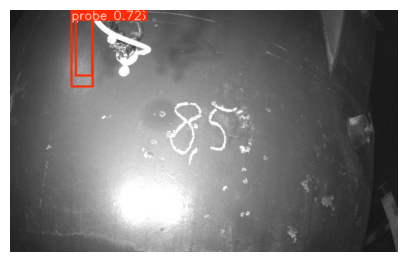


image 1/1 /content/probe_test_images/E300SA22440034_00447_133_1flight_8400_2.jpg: 416x640 1 probe, 30.3ms
Speed: 1.6ms preprocess, 30.3ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


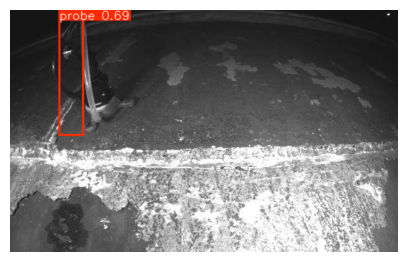


image 1/1 /content/probe_test_images/E300SA23130257_00057_043_1flight_11700_0.jpg: 416x640 (no detections), 32.6ms
Speed: 1.5ms preprocess, 32.6ms inference, 0.7ms postprocess per image at shape (1, 3, 416, 640)


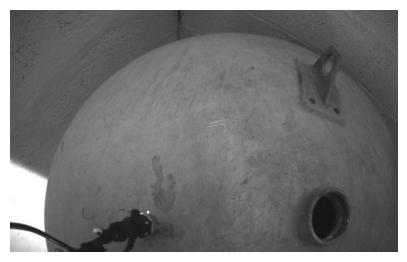


image 1/1 /content/probe_test_images/E300SA22440034_00447_133_1flight_9000_2.jpg: 416x640 1 probe, 26.9ms
Speed: 6.2ms preprocess, 26.9ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


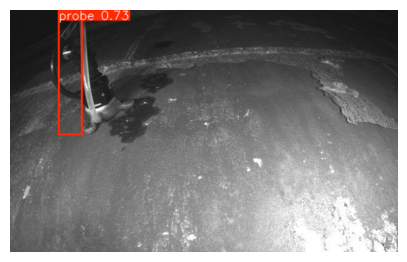


image 1/1 /content/probe_test_images/E300SA23130257_00060_045_1flight_900_0.jpg: 416x640 (no detections), 32.4ms
Speed: 1.5ms preprocess, 32.4ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


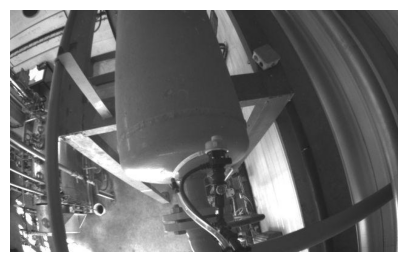


image 1/1 /content/probe_test_images/E300PREMP00002_00725_216_1flight_300_2.jpg: 416x640 1 probe, 29.9ms
Speed: 1.6ms preprocess, 29.9ms inference, 7.7ms postprocess per image at shape (1, 3, 416, 640)


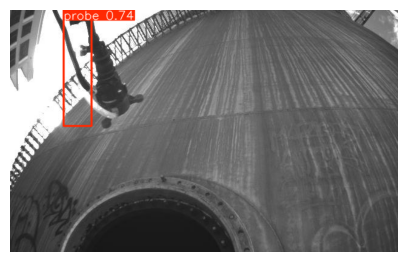


image 1/1 /content/probe_test_images/E300PREMP00002_00725_216_1flight_9300_2.jpg: 416x640 1 probe, 31.1ms
Speed: 1.5ms preprocess, 31.1ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


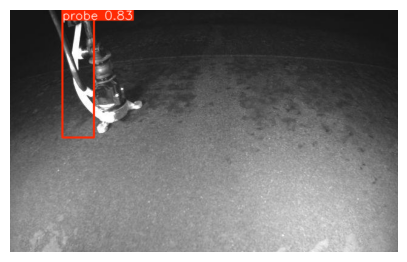


image 1/1 /content/probe_test_images/E300SA22440035_01533_862_1flight_1500_0.jpg: 416x640 1 probe, 28.0ms
Speed: 1.6ms preprocess, 28.0ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)


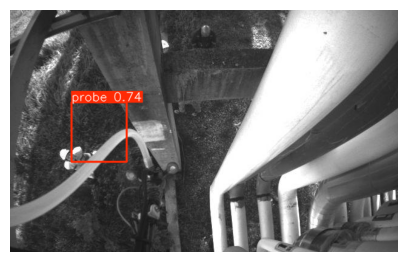


image 1/1 /content/probe_test_images/E300SA22440034_00451_135_1flight_2100_2.jpg: 416x640 1 probe, 26.9ms
Speed: 1.6ms preprocess, 26.9ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


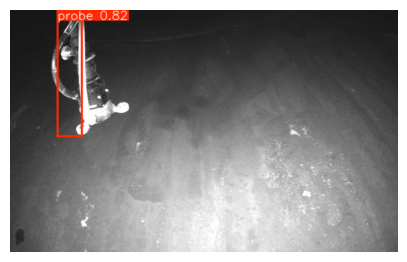


image 1/1 /content/probe_test_images/E300SA22440035_01510_843_1flight_10500_0.jpg: 416x640 (no detections), 27.4ms
Speed: 5.1ms preprocess, 27.4ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


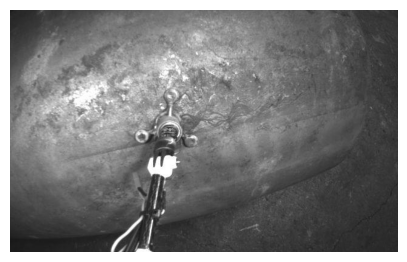


image 1/1 /content/probe_test_images/E300PREMP00002_00725_216_1flight_6300_2.jpg: 416x640 1 probe, 27.8ms
Speed: 1.6ms preprocess, 27.8ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


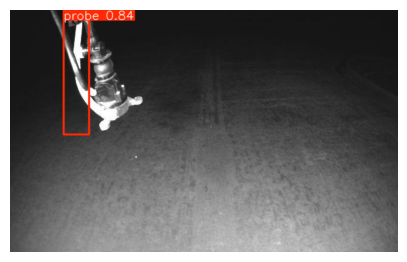


image 1/1 /content/probe_test_images/E300SA23130257_00295_209_1flight_11100_2.jpg: 416x640 1 probe, 26.9ms
Speed: 2.0ms preprocess, 26.9ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)


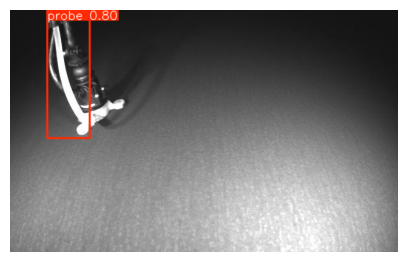


image 1/1 /content/probe_test_images/E300SA23130257_00053_034_1flight_1800_0.jpg: 416x640 (no detections), 27.0ms
Speed: 3.8ms preprocess, 27.0ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


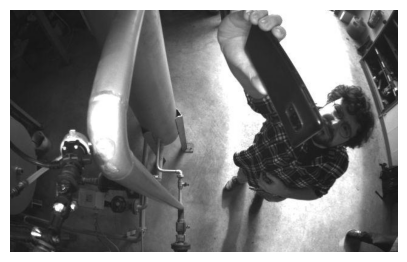


image 1/1 /content/probe_test_images/E300SA23130257_00267_199_1flight_6000_2.jpg: 416x640 1 probe, 26.9ms
Speed: 1.6ms preprocess, 26.9ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


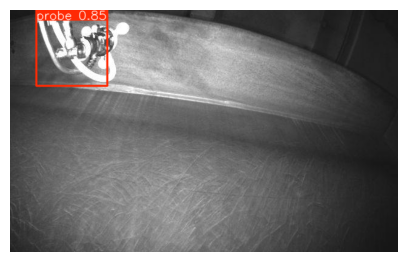


image 1/1 /content/probe_test_images/E300SA23130257_00053_033_1flight_3900_0.jpg: 416x640 (no detections), 26.9ms
Speed: 1.7ms preprocess, 26.9ms inference, 2.7ms postprocess per image at shape (1, 3, 416, 640)


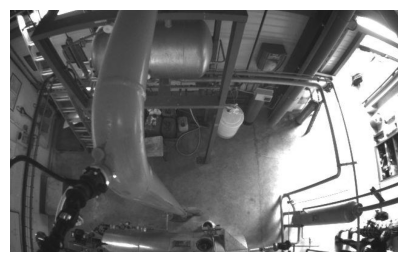

In [ ]:
from ultralytics import YOLO
import  cv2
import cvzone
import math
import matplotlib.pyplot as plt

model_best = YOLO("best.pt")
classNames = ["probe"]
test_path = "/content/probe_test_images"     # define the path here

for img in os.listdir(test_path) :
  results = model_best.predict(test_path + '/' + img)
  imag = results[0].plot()
  plt.figure(figsize=(5,5))
  plt.imshow(imag)
  plt.axis('off')
  plt.show()

### Model train using Yolo 8 large with batch size and Learning rate change,
### WORST MODEL***

In [ ]:
from ultralytics import YOLO

# Load a model
model_m3 = YOLO("yolov8l.yaml")  # build a new model from YAML
model_m3 = YOLO("yolov8l.pt")  # load a pretrained model (recommended for training)
model_m3 = YOLO("yolov8l.yaml").load("yolov8l.pt")  # build from YAML and transfer weights

# Train the model
results_m3 = model_m3.train(data="/content/data/data.yaml", epochs=50, batch=4, lr0 = 0.0005)

100%|██████████| 83.7M/83.7M [00:00<00:00, 130MB/s]


Transferred 595/595 items from pretrained weights
Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8l.yaml, data=/content/data/data.yaml, epochs=50, time=None, patience=100, batch=4, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5, exist_ok=False, pretrained=yolov8l.pt, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_c

train: Scanning /content/data/train/labels.cache... 249 images, 0 backgrounds, 0 corrupt: 100%|██████████| 249/249 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/data/val/labels.cache... 28 images, 0 backgrounds, 0 corrupt: 100%|██████████| 28/28 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0005' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train5
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      4.82G      2.815      5.098      2.457          1        640: 100%|██████████| 63/63 [00:17<00:00,  3.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.20it/s]

                   all         28         28     0.0013      0.357    0.00112   0.000229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      4.66G      3.224      3.859      2.836          2        640: 100%|██████████| 63/63 [00:15<00:00,  4.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.35it/s]

                   all         28         28   0.000126     0.0357   6.89e-05   6.89e-06



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      4.66G      3.255      3.972      2.798          2        640: 100%|██████████| 63/63 [00:15<00:00,  4.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.59it/s]

                   all         28         28   0.000126     0.0357   6.89e-05   6.89e-06



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      4.68G      3.147      3.862      2.701          1        640: 100%|██████████| 63/63 [00:15<00:00,  4.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.14it/s]

                   all         28         28   0.000833       0.25   0.000728   0.000116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      4.68G      3.058      3.739      2.677          0        640: 100%|██████████| 63/63 [00:16<00:00,  3.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.44it/s]

                   all         28         28   0.000292     0.0357   0.000158   0.000111



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      4.68G      2.957      3.752      2.614          4        640: 100%|██████████| 63/63 [00:15<00:00,  4.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.94it/s]

                   all         28         28    0.00173       0.25     0.0131    0.00545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      4.68G      2.946      3.627      2.623          4        640: 100%|██████████| 63/63 [00:15<00:00,  4.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.23it/s]

                   all         28         28     0.0985      0.107     0.0487     0.0137



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      4.67G      2.928      3.693       2.53          4        640: 100%|██████████| 63/63 [00:14<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.71it/s]

                   all         28         28      0.096     0.0357      0.015    0.00369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      4.67G      2.728      3.575      2.438          2        640: 100%|██████████| 63/63 [00:16<00:00,  3.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.18it/s]


                   all         28         28      0.004        0.5    0.00948    0.00316

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      4.65G        2.8      3.636      2.507          2        640: 100%|██████████| 63/63 [00:14<00:00,  4.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.81it/s]

                   all         28         28     0.0863      0.214     0.0433     0.0136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      4.65G      2.907      3.667      2.507          4        640: 100%|██████████| 63/63 [00:15<00:00,  4.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.42it/s]

                   all         28         28      0.102      0.107     0.0432     0.0139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      4.66G      2.733      3.468      2.415          3        640: 100%|██████████| 63/63 [00:16<00:00,  3.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.41it/s]

                   all         28         28     0.0695      0.286      0.133      0.044



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      4.66G      2.815      3.583      2.447          1        640: 100%|██████████| 63/63 [00:16<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.46it/s]

                   all         28         28      0.117     0.0714      0.087     0.0215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      4.51G      2.675      3.492      2.368          4        640: 100%|██████████| 63/63 [00:15<00:00,  4.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.81it/s]

                   all         28         28       0.28      0.214      0.158     0.0339



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      4.65G      2.614      3.486      2.348          2        640: 100%|██████████| 63/63 [00:14<00:00,  4.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.58it/s]

                   all         28         28      0.248      0.179      0.127     0.0526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      4.67G      2.677      3.485       2.39          1        640: 100%|██████████| 63/63 [00:14<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.46it/s]

                   all         28         28      0.427      0.214      0.133     0.0414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      4.67G      2.609      3.431      2.369          1        640: 100%|██████████| 63/63 [00:14<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.31it/s]

                   all         28         28      0.275      0.179      0.158     0.0515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      4.68G      2.561      3.398      2.326          2        640: 100%|██████████| 63/63 [00:16<00:00,  3.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.31it/s]

                   all         28         28      0.251      0.214      0.161     0.0598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      4.66G      2.544      3.351      2.326          2        640: 100%|██████████| 63/63 [00:15<00:00,  4.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.65it/s]

                   all         28         28      0.362      0.143      0.143     0.0511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      4.68G      2.495      3.255      2.319          2        640: 100%|██████████| 63/63 [00:14<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.52it/s]

                   all         28         28      0.324      0.179      0.153     0.0564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      4.65G       2.57      3.306      2.341          1        640: 100%|██████████| 63/63 [00:15<00:00,  4.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.50it/s]

                   all         28         28      0.351      0.179      0.211     0.0713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      4.65G      2.486      3.239       2.32          1        640: 100%|██████████| 63/63 [00:16<00:00,  3.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.46it/s]

                   all         28         28       0.44      0.169      0.189     0.0844



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      4.67G      2.462      3.241      2.279          1        640: 100%|██████████| 63/63 [00:15<00:00,  4.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.82it/s]

                   all         28         28      0.376       0.25      0.209     0.0744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      4.65G      2.392      3.162      2.202          2        640: 100%|██████████| 63/63 [00:15<00:00,  4.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.93it/s]

                   all         28         28      0.375      0.179      0.187     0.0865



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      4.66G       2.39      3.219      2.221          1        640: 100%|██████████| 63/63 [00:15<00:00,  3.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.57it/s]

                   all         28         28      0.371      0.179      0.213     0.0924



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      4.66G      2.373      3.131      2.205          1        640: 100%|██████████| 63/63 [00:16<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.48it/s]

                   all         28         28      0.399       0.25      0.214     0.0867



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      4.65G      2.303      3.076      2.163          2        640: 100%|██████████| 63/63 [00:15<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.59it/s]

                   all         28         28      0.232      0.321      0.236      0.107



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      4.65G      2.342      3.146      2.216          4        640: 100%|██████████| 63/63 [00:15<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.87it/s]

                   all         28         28      0.407      0.214       0.19     0.0732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      4.68G      2.296      3.021      2.195          1        640: 100%|██████████| 63/63 [00:16<00:00,  3.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.43it/s]

                   all         28         28       0.59       0.25      0.253     0.0932



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      4.47G       2.26      3.107      2.152          1        640: 100%|██████████| 63/63 [00:14<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  6.87it/s]

                   all         28         28      0.357      0.219      0.198     0.0702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      4.66G      2.223      2.957      2.097          4        640: 100%|██████████| 63/63 [00:15<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.49it/s]

                   all         28         28      0.659      0.214      0.246      0.105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      4.67G      2.249      3.035      2.144          2        640: 100%|██████████| 63/63 [00:15<00:00,  4.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.63it/s]

                   all         28         28      0.602       0.25      0.249      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      4.67G      2.328       3.01        2.2          2        640: 100%|██████████| 63/63 [00:15<00:00,  4.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.59it/s]

                   all         28         28       0.45      0.205      0.242     0.0883



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      4.68G      2.206      2.939      2.126          3        640: 100%|██████████| 63/63 [00:14<00:00,  4.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.37it/s]

                   all         28         28      0.375       0.25      0.237      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      4.67G      2.203       2.93      2.116          2        640: 100%|██████████| 63/63 [00:14<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.71it/s]

                   all         28         28      0.522      0.235      0.252        0.1



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      4.65G      2.263      3.068      2.158          2        640: 100%|██████████| 63/63 [00:15<00:00,  4.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  8.75it/s]

                   all         28         28      0.529       0.25      0.264      0.122



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      4.67G       2.15      2.804      2.067          3        640: 100%|██████████| 63/63 [00:15<00:00,  3.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.71it/s]

                   all         28         28      0.428       0.25      0.247      0.102



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      4.65G       2.16      2.905      2.094          0        640: 100%|██████████| 63/63 [00:16<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.47it/s]

                   all         28         28      0.441      0.286      0.258       0.11



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      4.67G      2.181      2.958      2.116          2        640: 100%|██████████| 63/63 [00:16<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.23it/s]

                   all         28         28      0.693      0.286      0.341      0.151



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      4.67G        2.1      2.825      2.065          2        640: 100%|██████████| 63/63 [00:15<00:00,  4.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.86it/s]

                   all         28         28       0.59       0.25      0.265      0.128


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      4.67G      2.126      2.968      2.093          1        640: 100%|██████████| 63/63 [00:15<00:00,  4.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.95it/s]

                   all         28         28      0.364      0.179      0.215      0.119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      4.65G       2.12      2.871      2.087          1        640: 100%|██████████| 63/63 [00:16<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.11it/s]


                   all         28         28       0.49       0.25      0.251      0.134

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      4.67G      2.052      2.838      2.015          1        640: 100%|██████████| 63/63 [00:15<00:00,  4.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.51it/s]

                   all         28         28      0.808      0.286      0.372      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      4.65G      2.013      2.684      1.998          1        640: 100%|██████████| 63/63 [00:16<00:00,  3.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.22it/s]

                   all         28         28      0.614      0.357      0.375      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      4.67G      2.009      2.669      2.042          1        640: 100%|██████████| 63/63 [00:14<00:00,  4.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.86it/s]

                   all         28         28      0.663      0.393       0.41      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50       4.5G      2.037      2.754      2.028          1        640: 100%|██████████| 63/63 [00:16<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.49it/s]

                   all         28         28      0.623      0.321      0.369      0.182



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      4.67G      1.985      2.639      2.012          1        640: 100%|██████████| 63/63 [00:16<00:00,  3.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.58it/s]

                   all         28         28      0.633      0.357      0.385      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      4.68G      1.848      2.494      1.933          1        640: 100%|██████████| 63/63 [00:14<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.62it/s]

                   all         28         28      0.863      0.357      0.391      0.217



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      4.65G      1.967      2.571      2.008          1        640: 100%|██████████| 63/63 [00:16<00:00,  3.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  9.54it/s]

                   all         28         28      0.763      0.321      0.375      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      4.66G      1.949      2.569      1.982          1        640: 100%|██████████| 63/63 [00:15<00:00,  4.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  7.36it/s]

                   all         28         28      0.807      0.321      0.374      0.212



50 epochs completed in 0.527 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 87.6MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 87.6MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics 8.3.59 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8l summary (fused): 268 layers, 43,607,379 parameters, 0 gradients, 164.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.77it/s]


                   all         28         28      0.863      0.357      0.391      0.217
Speed: 0.6ms preprocess, 14.4ms inference, 0.0ms loss, 3.4ms postprocess per image
Results saved to runs/detect/train5



image 1/1 /content/data/test/images/E300SA22440035_01533_862_1flight_6300_0.jpg: 416x640 (no detections), 69.7ms
Speed: 1.7ms preprocess, 69.7ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)


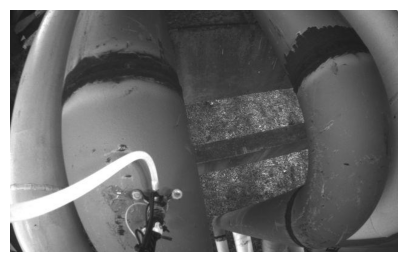


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_8700_2.jpg: 416x640 2 probes, 39.1ms
Speed: 1.7ms preprocess, 39.1ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 640)


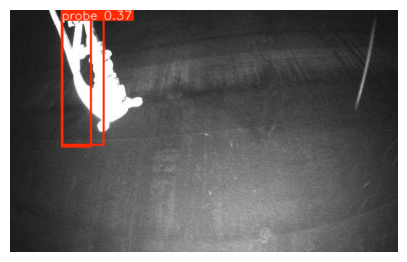


image 1/1 /content/data/test/images/EL300858804493_00188_043_1flight_3000_0.jpg: 416x640 (no detections), 41.7ms
Speed: 1.7ms preprocess, 41.7ms inference, 2.6ms postprocess per image at shape (1, 3, 416, 640)


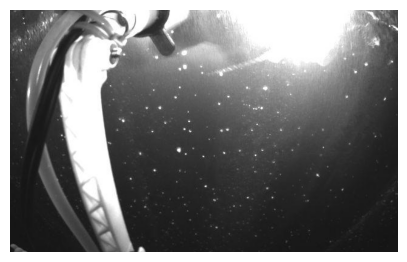


image 1/1 /content/data/test/images/EL300858804493_00330_112_1flight_9600_2.jpg: 416x640 (no detections), 37.4ms
Speed: 1.6ms preprocess, 37.4ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


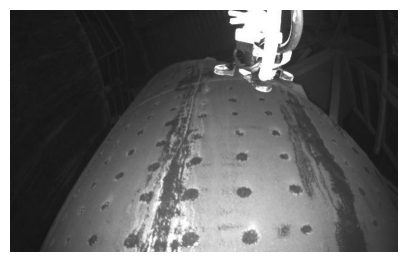


image 1/1 /content/data/test/images/E300SA23130257_00057_043_1flight_8100_0.jpg: 416x640 (no detections), 44.7ms
Speed: 4.2ms preprocess, 44.7ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)


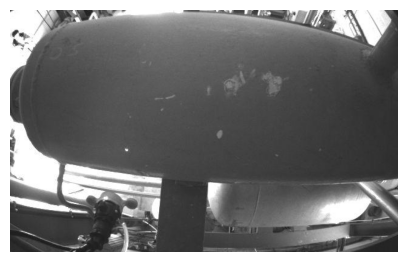


image 1/1 /content/data/test/images/EL300858804493_00184_039_1flight_9300_2.jpg: 416x640 3 probes, 36.9ms
Speed: 1.7ms preprocess, 36.9ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


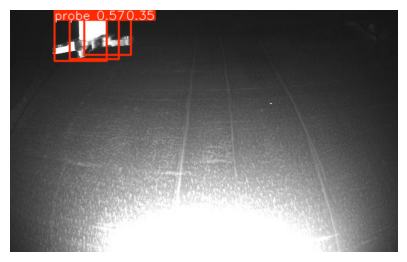


image 1/1 /content/data/test/images/E300SA22440034_00452_136_1flight_2100_2.jpg: 416x640 (no detections), 36.9ms
Speed: 1.8ms preprocess, 36.9ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


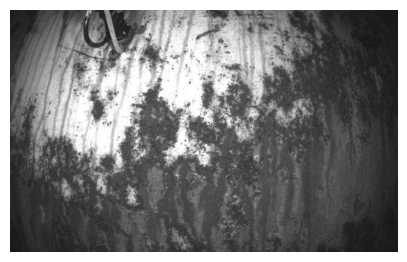


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_900_2.jpg: 416x640 1 probe, 36.9ms
Speed: 1.7ms preprocess, 36.9ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)


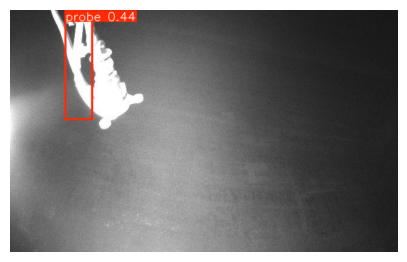


image 1/1 /content/data/test/images/E300SA23130257_00295_209_1flight_0_2.jpg: 416x640 3 probes, 36.9ms
Speed: 1.7ms preprocess, 36.9ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)


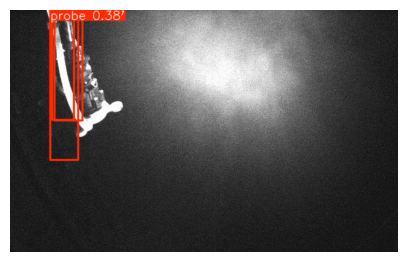


image 1/1 /content/data/test/images/EL300858804493_00193_048_1flight_1500_0.jpg: 416x640 (no detections), 49.5ms
Speed: 1.6ms preprocess, 49.5ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)


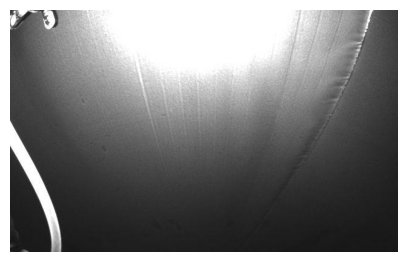


image 1/1 /content/data/test/images/E300SA23130257_00301_214_1flight_900_0.jpg: 416x640 (no detections), 50.8ms
Speed: 1.7ms preprocess, 50.8ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


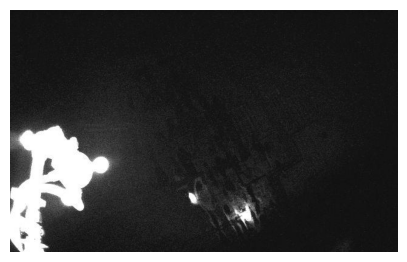


image 1/1 /content/data/test/images/EL300858804493_00330_112_1flight_2400_2.jpg: 416x640 (no detections), 52.2ms
Speed: 6.1ms preprocess, 52.2ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


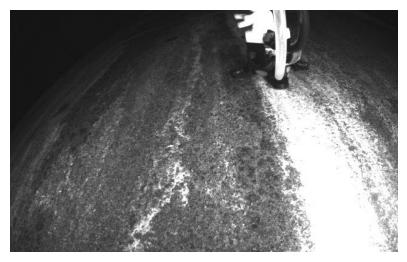


image 1/1 /content/data/test/images/E300SA23130257_00054_035_1flight_1200_0.jpg: 416x640 (no detections), 49.5ms
Speed: 1.6ms preprocess, 49.5ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


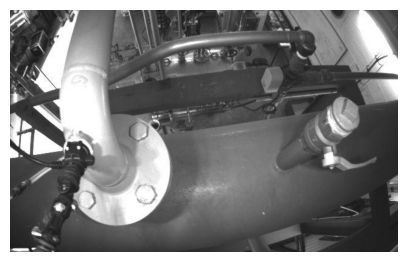


image 1/1 /content/data/test/images/EL300858804493_00184_039_1flight_3300_2.jpg: 416x640 (no detections), 51.8ms
Speed: 1.6ms preprocess, 51.8ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


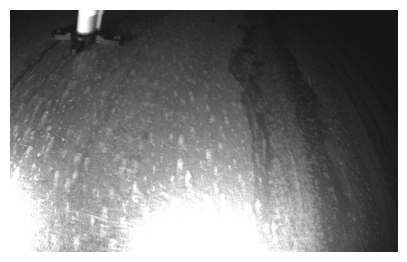


image 1/1 /content/data/test/images/E300SA22440034_00451_135_1flight_3000_2.jpg: 416x640 1 probe, 49.6ms
Speed: 2.8ms preprocess, 49.6ms inference, 3.2ms postprocess per image at shape (1, 3, 416, 640)


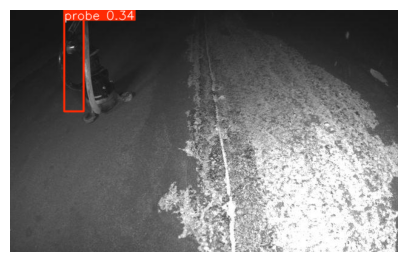


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_3900_2.jpg: 416x640 1 probe, 51.4ms
Speed: 1.9ms preprocess, 51.4ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


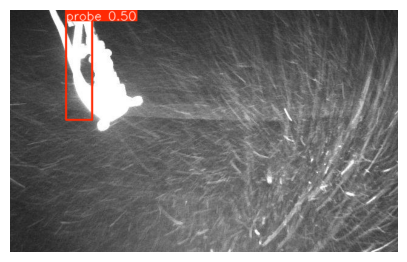


image 1/1 /content/data/test/images/E300SA22440034_00465_143_1flight_1800_2.jpg: 416x640 1 probe, 53.0ms
Speed: 1.6ms preprocess, 53.0ms inference, 6.1ms postprocess per image at shape (1, 3, 416, 640)


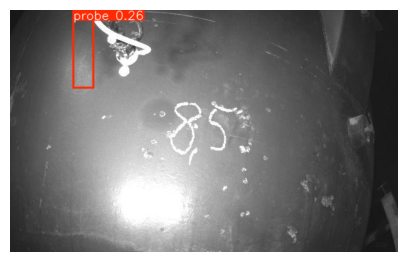


image 1/1 /content/data/test/images/E300SA22440034_00447_133_1flight_8400_2.jpg: 416x640 (no detections), 49.5ms
Speed: 5.7ms preprocess, 49.5ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 640)


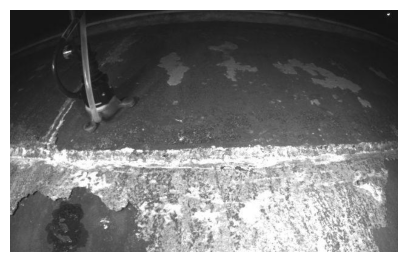


image 1/1 /content/data/test/images/E300SA23130257_00057_043_1flight_11700_0.jpg: 416x640 (no detections), 49.5ms
Speed: 1.6ms preprocess, 49.5ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)


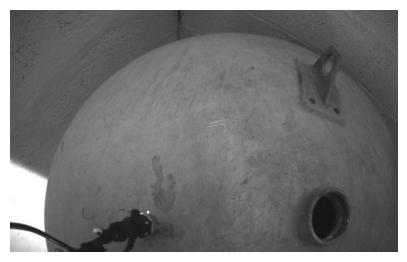


image 1/1 /content/data/test/images/E300SA22440034_00447_133_1flight_9000_2.jpg: 416x640 3 probes, 49.5ms
Speed: 1.6ms preprocess, 49.5ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


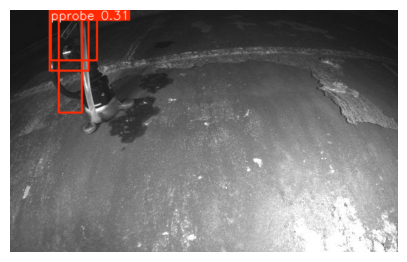


image 1/1 /content/data/test/images/E300SA23130257_00060_045_1flight_900_0.jpg: 416x640 (no detections), 49.5ms
Speed: 1.7ms preprocess, 49.5ms inference, 0.9ms postprocess per image at shape (1, 3, 416, 640)


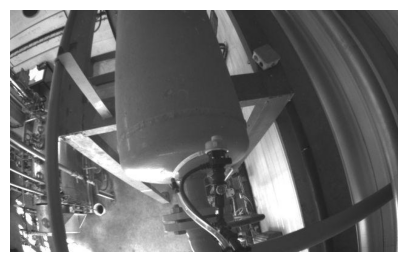


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_300_2.jpg: 416x640 1 probe, 49.5ms
Speed: 1.8ms preprocess, 49.5ms inference, 7.5ms postprocess per image at shape (1, 3, 416, 640)


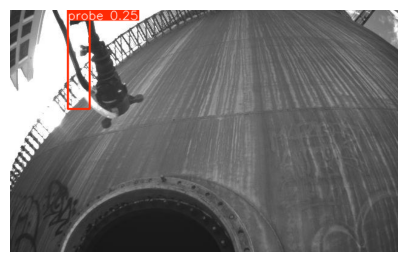


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_9300_2.jpg: 416x640 1 probe, 49.5ms
Speed: 1.6ms preprocess, 49.5ms inference, 5.9ms postprocess per image at shape (1, 3, 416, 640)


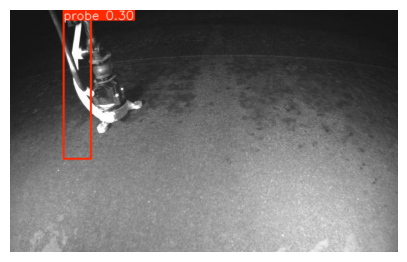


image 1/1 /content/data/test/images/E300SA22440035_01533_862_1flight_1500_0.jpg: 416x640 (no detections), 49.5ms
Speed: 1.5ms preprocess, 49.5ms inference, 5.8ms postprocess per image at shape (1, 3, 416, 640)


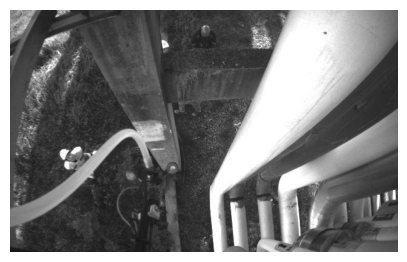


image 1/1 /content/data/test/images/E300SA22440034_00451_135_1flight_2100_2.jpg: 416x640 4 probes, 50.2ms
Speed: 1.5ms preprocess, 50.2ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 640)


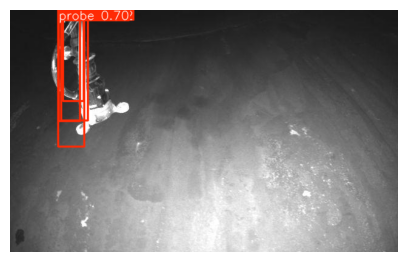


image 1/1 /content/data/test/images/E300SA22440035_01510_843_1flight_10500_0.jpg: 416x640 (no detections), 51.3ms
Speed: 1.6ms preprocess, 51.3ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


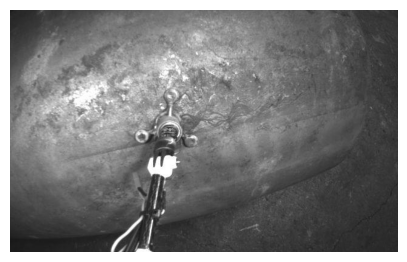


image 1/1 /content/data/test/images/E300PREMP00002_00725_216_1flight_6300_2.jpg: 416x640 2 probes, 49.5ms
Speed: 1.6ms preprocess, 49.5ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


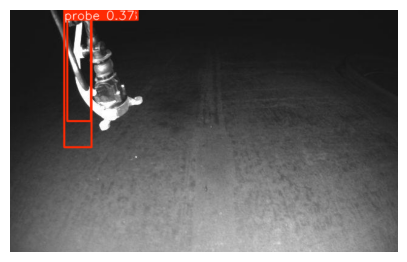


image 1/1 /content/data/test/images/E300SA23130257_00295_209_1flight_11100_2.jpg: 416x640 1 probe, 49.5ms
Speed: 1.6ms preprocess, 49.5ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 640)


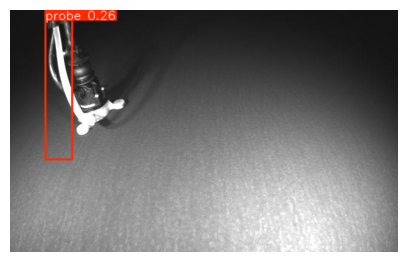


image 1/1 /content/data/test/images/E300SA23130257_00053_034_1flight_1800_0.jpg: 416x640 (no detections), 49.5ms
Speed: 1.7ms preprocess, 49.5ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 640)


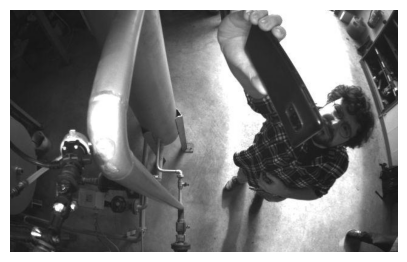


image 1/1 /content/data/test/images/E300SA23130257_00267_199_1flight_6000_2.jpg: 416x640 (no detections), 49.5ms
Speed: 1.8ms preprocess, 49.5ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


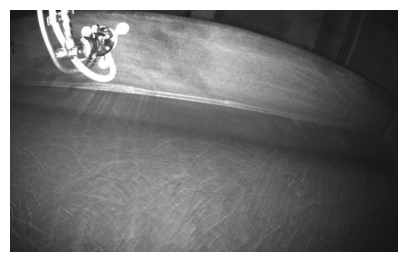


image 1/1 /content/data/test/images/E300SA23130257_00053_033_1flight_3900_0.jpg: 416x640 (no detections), 49.6ms
Speed: 1.7ms preprocess, 49.6ms inference, 0.8ms postprocess per image at shape (1, 3, 416, 640)


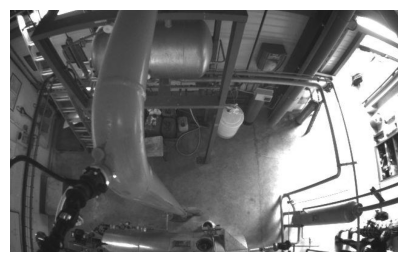

In [ ]:
from ultralytics import YOLO
import  cv2
import cvzone
import math
import matplotlib.pyplot as plt

classNames = ["probe"]
for img in os.listdir(test_path) :
  results = model_m3.predict(test_path + '/' + img)
  imag = results[0].plot()
  plt.figure(figsize=(5,5))
  plt.imshow(imag)
  plt.axis('off')
  plt.show()